In [4]:
%%capture
import numpy as np
import pandas as pd
from urbansim.models import dcm

import orca
import datasources
import variables
import models

import warnings
warnings.filterwarnings("ignore")

### CONCEPTUAL
The concept of these HLCMs estimations migrates the idea of the choosers being all households in the table to the choosers being those households who were unallocated after the transition and relocation models. <br>
#### STEPS
The following steps are executed in order to estime chooser-mover hlcms. Before running any model, the base households table is saved as “hh_2015” in order to keep the building_id column which will correspond to the choice column. Then, the transition and relocation models are run. With a new households orca table where there are relocated and transitioned (new and dropped) households, the building_id is merged to the “hh_2015” table based on the household_id. The new building_id column is called “building_id_2016”. This column will reveal with a value of -1 those households that were relocated after running the models.
Afterwards, the choosers and alternatives tables are created to estimate models at a unit-level (hh_spot_id), using the choices of the households as the building_id of the “hh_2015” and those alternatives with vacant residential units after the models ran. In the estimation stage, the households that have now a building_id_2016 == -1 will be tagged as movers. So, the fitting is done with the choosers as the households with `building_id_2016 == -1`, with their observed choice before being unplaced, and the alternatives are all units with vacant_residential_units > 0, so buildings that after the relocation and transition model were left with space.

In [11]:
import seaborn as sb
import matplotlib.pyplot as plt
% matplotlib inline

Number of hh: 1,862,504


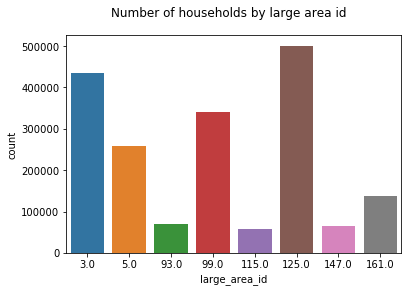

Number of unallocated households: 0
Number of buildings: 1,660,654


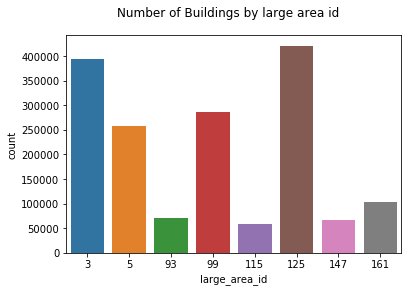

Number of Residential Units: 1,660,654


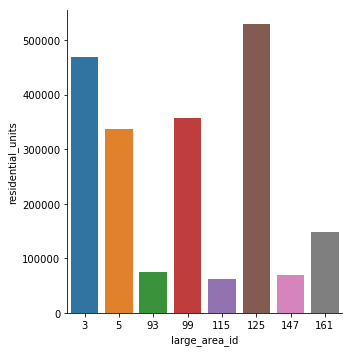

Number of Empty Buildings: 0
Number of vacant residential units: 185,303.0
large_area_id
3      36315.0
5      80440.0
93      3629.0
99     17609.0
115     3958.0
125    28429.0
147     5210.0
161     9713.0
Name: vacant_residential_units, dtype: float64


In [31]:
hh = orca.get_table('households').to_frame(orca.get_table('households').local_columns + ['household_type'])
print('Number of hh: {:,}'.format(len(hh)))
ax = sb.countplot(x='large_area_id' , data=hh)
plt.suptitle('Number of households by large area id')
plt.show()
# print('Households by large area: \n{}'.format(hh.large_area_id.value_counts()))
print('Number of unallocated households: {:,}'.format(len(hh[hh.building_id == -1])))

bldg = orca.get_table('buildings').to_frame(['large_area_id', 'residential_units', 'vacant_residential_units'])
print('Number of buildings: {:,}'.format(len(bldg)))
ax = sb.countplot(x='large_area_id' , data=bldg)
plt.suptitle('Number of Buildings by large area id')
plt.show()
# print('Buildings by large area: \n{}'.format(bldg.large_area_id.value_counts()))
print('Number of Residential Units: {:,}'.format(len(bldg)))
ax = sb.catplot(x='large_area_id' ,y= 'residential_units', kind='bar',
                data=bldg.groupby('large_area_id').residential_units.sum().reset_index())
plt.show()
# print('Residential Units by large area: \n{}'.format(bldg.groupby('large_area_id').residential_units.sum()))
print('Number of Empty Buildings: {:,}'.format(len(hh[hh.building_id == -1])))
print('Number of vacant residential units: {:,}\n{}'.format(bldg.vacant_residential_units.sum(),
                                                        bldg.groupby('large_area_id').vacant_residential_units.sum()))

In [32]:
# ADD TO THE ORCA TABLE A FIX COLUMN WITH THE BUILDING ID 2015
orca.add_column('households', 'building_id_2015', hh.building_id)
orca.add_column('buildings', 'vacant_2015', bldg.vacant_residential_units)

In [33]:
# BEFORE RUNNING THE RELOCATION AND TRANSITION MODELS THERE SHOULD NOT BE NULL VALUES IN BLDG ID 2015
orca.get_table('households').to_frame(['building_id_2015']).building_id_2015.isnull().sum()

0

In [34]:
# RUN TRANSITION AND RELOCATION MODELS, so next building ids will be of 2016. 
transition_semcog = ['households_transition_semcog']
relocation_models = ['households_relocation']
orca.run(transition_semcog + relocation_models, iter_vars=[2015])

Running iteration 1 with iteration value 2015
Running step 'households_transition_semcog'
Time to execute step 'households_transition_semcog': 289.67 s
Running step 'households_relocation'
Total currently unplaced: 55816
Agents (households) unplaced by relocation: 34580
Total currently unplaced: 89158
Time to execute step 'households_relocation': 7.71 s
Total time to execute iteration 1 with iteration value 2015: 297.39 s


Number of hh: 1,866,831


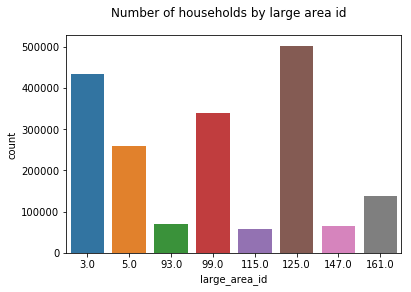

Number of unallocated households in 2016: 89,158
Number of buildings: 1,660,654


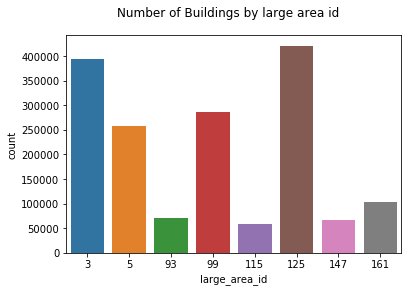

Number of Residential Units: 1,660,654


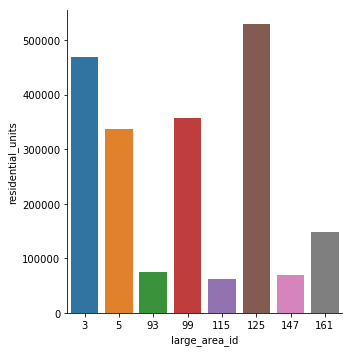

Number of Empty Buildings: 89,158
Number of vacant residential units: 270,134.0
large_area_id
3      55981.0
5      90948.0
93      8257.0
99     31976.0
115     8014.0
125    46458.0
147     8829.0
161    19671.0
Name: vacant_residential_units, dtype: float64


In [36]:
hh_16 = orca.get_table('households').local
# print('Number of hh: {:,}'.format(len(hh_16)))
# print('Households by large area: \n{}'.format(hh_16.large_area_id.value_counts()))
# print('Number of unallocated households: {:,}'.format(len(hh_16[hh_16.building_id == -1])))

# bldg_16 = orca.get_table('buildings').to_frame(['large_area_id', 'residential_units', 'vacant_residential_units'])
# print('Number of buildings: {:,}'.format(len(bldg)))
# print('Buildings by large area: \n{}'.format(bldg.large_area_id.value_counts()))
# print('Number of Residential Units: {:,}'.format(len(bldg)))
# print('Residential Units by large area: \n{}'.format(bldg.groupby('large_area_id').residential_units.sum()))
# print('Number of Empty Buildings: {:,}'.format(len(hh[hh.building_id == -1])))
# print('Number of vacant residential units: {:,} \n{}'.format(bldg.vacant_residential_units.sum(),
#                                                         bldg.groupby('large_area_id').vacant_residential_units.sum()))
print('Number of hh: {:,}'.format(len(hh_16)))
ax = sb.countplot(x='large_area_id' , data=hh_16)
plt.suptitle('Number of households by large area id')
plt.show()
# print('Households by large area: \n{}'.format(hh_16.large_area_id.value_counts()))
print('Number of unallocated households in 2016: {:,}'.format(len(hh_16[hh_16.building_id == -1])))

bldg_16 = orca.get_table('buildings').to_frame(['large_area_id', 'residential_units', 'vacant_residential_units'])
print('Number of buildings: {:,}'.format(len(bldg_16)))
ax = sb.countplot(x='large_area_id' , data=bldg_16)
plt.suptitle('Number of Buildings by large area id')
plt.show()
# print('Buildings by large area: \n{}'.format(bldg_16.large_area_id.value_counts()))
print('Number of Residential Units: {:,}'.format(len(bldg_16)))
ax = sb.catplot(x='large_area_id' ,y= 'residential_units', kind='bar',
                data=bldg_16.groupby('large_area_id').residential_units.sum().reset_index())
plt.show()
# print('Residential Units by large area: \n{}'.format(bldg_16.groupby('large_area_id').residential_units.sum()))
print('Number of Empty Buildings: {:,}'.format(len(hh_16[hh_16.building_id == -1])))
print('Number of vacant residential units: {:,}\n{}'.format(bldg_16.vacant_residential_units.sum(),
                                                        bldg_16.groupby('large_area_id').vacant_residential_units.sum()))

In [39]:
# Add to the 2015 households table the households to got unallocated
households_2016 = orca.get_table('households').to_frame(['building_id']).rename(columns = {'building_id':'building_id_16'})
hh2 = hh.join(households_2016)
print('Number of HH that got unalloacted in 2016:{:,}'.format(len(hh2[hh2.building_id_16 == -1])))
print('Number of HH deleted in 2016 {:,}'.format(len(hh2[hh2.building_id_16.isnull()])))
hh2.building_id_16.fillna(-1, inplace=True)
print('Finally, all relocated/transitioned hh that will be the choosers in the HLCMS: {:,}'.format(len(hh2[hh2.building_id_16 == -1])))

Number of HH that got unalloacted in 2016:33,342
Number of HH deleted in 2016 51,489
Finally, all relocated/transitioned hh that will be the choosers in the HLCMS:84,831


In [40]:
hh2.head()

,building_id,large_area_id,cars,workers,persons,race_id,income,age_of_head,children,household_type,building_id_16
930000000,7116155,93.0,2,1,5,1,112773.650,42.0,3.0,17,7116155.0
930000001,7114247,93.0,2,2,5,1,114083.105,36.0,3.0,17,7114247.0
930000002,7115505,93.0,2,1,5,1,119131.030,38.0,3.0,17,7115505.0
930000003,7115305,93.0,2,1,4,1,123025.800,40.0,3.0,17,7115305.0
930000004,7116760,93.0,3,1,5,1,102977.670,44.0,3.0,17,7116760.0


In [41]:
hh2[hh2.building_id_16==-1].household_type.value_counts()

11    17433
17    14504
12     7761
5      6719
8      6043
2      5647
6      5562
9      5403
3      5376
7      2240
10     1866
18     1551
1      1275
14     1219
16      654
15      560
4       528
13      490
Name: household_type, dtype: int64

In [42]:
# Getting all the variables from the hcl clustvars models
import yaml
import os
path = 'configs/lcm_regional_clustvars/hlcm/'
hlcm_files = os.listdir(path)
hlcm_vars = []
for filen in hlcm_files:
    with open(path + filen) as f:
        store = yaml.safe_load(f)
        hlcm_vars.extend(store['model_expression'])
hlcm_vars = set(hlcm_vars)

In [135]:
# Alternatives and choosers
# Alternatives are the 2016 buildings, specifically the vacant units 
hlcm_vars2 = list(hlcm_vars) + ['residential_units', 'vacant_residential_units', 'zone_id', 'mode_income_quartile', 
                                'parcel_id']
alternatives = orca.get_table('buildings').to_frame(hlcm_vars2)
# choosers = orca.get_table('households').to_frame(['building_id', 'household_type', 'building_id_2015'])
# CHOOSERS ARE THE 2015 HOUSEHOLDS WITH building_id_16 ==-1 but their choice is 2015 id
choosers = hh2.copy()

In [136]:
### Unit-level alternatives: adding spot_id
buildings = orca.get_table('buildings').to_frame(['vacant_residential_units'])
units_reloca16 = choosers[choosers.building_id_16 == -1].groupby('building_id').count()[['building_id_16']]
buildings = buildings.join(units_reloca16).fillna(0)
buildings['vacant_residential_units'] = buildings.vacant_residential_units - buildings.building_id_16
remaining_hh_capac = buildings.vacant_residential_units
vacant_hh_spots = np.repeat(remaining_hh_capac.index, remaining_hh_capac.values.astype(int))

occupied_hh_spots = choosers[choosers.building_id_16 == -1].building_id
occupied_hh_spots = pd.DataFrame(occupied_hh_spots)
occupied_hh_spots['occupied'] = 0
relocated_hh_spots = choosers[(choosers.building_id != -1) & (choosers.building_id_16 != -1)].building_id
relocated_hh_spots = pd.DataFrame(relocated_hh_spots)
relocated_hh_spots['occupied'] = 1
used_hh_spots = pd.concat([relocated_hh_spots, occupied_hh_spots])

next_id = used_hh_spots.index.max() + 1
vacant_idx = np.arange(next_id, next_id + len(vacant_hh_spots)) 
vacant_hh_spots = pd.Series(vacant_hh_spots, index = vacant_idx)
vacant_hh_spots = pd.DataFrame(vacant_hh_spots)
vacant_hh_spots['occupied'] = 0

hh_spots = pd.concat([used_hh_spots, vacant_hh_spots])
hh_spots.index.name = 'hh_spot_id'

choosers['hh_spot_id'] = choosers.index.values

alternatives = pd.merge(hh_spots, alternatives, left_on='building_id', right_index=True)

print hh_spots.occupied.value_counts()

1    1777673
0     270134
Name: occupied, dtype: int64


In [137]:
occupied_hh_spots.head()

,building_id,occupied
930000007,7116380,0
930000009,7113873,0
930000020,7116244,0
930000026,7114568,0
930000029,7116805,0


In [138]:
choosers[choosers.building_id_16 == -1].head()

,building_id,large_area_id,cars,workers,persons,race_id,income,age_of_head,children,household_type,building_id_16,hh_spot_id
930000007,7116380,93.0,2,1,4,1,180227.520,40.0,1.0,17,-1.0,930000007
930000009,7113873,93.0,4,2,4,1,209993.680,43.0,1.0,17,-1.0,930000009
930000020,7116244,93.0,2,2,5,1,343390.080,43.0,1.0,17,-1.0,930000020
930000026,7114568,93.0,2,2,5,1,151731.820,40.0,2.0,17,-1.0,930000026
930000029,7116805,93.0,2,2,5,1,118149.152,34.0,2.0,18,-1.0,930000029


In [141]:
alternatives[alternatives.building_id == 7116380]

building_id                            270134
occupied                               270134
residential_units                      270134
parcel_id                              270134
st_zones_prop_race_2                   270134
st_zones_prop_race_3                   270134
st_zones_popden                        270134
st_zones_households                    270134
vacant_residential_units               270134
st_b_ln_building_sqft                  270134
st_b_ln_sqft_per_unit                  270134
st_zones_ln_popden                     270134
st_zones_sum_residential_units         270134
st_zones_empden                        270134
st_zones_logsum_pop_high_income        270134
st_building_age                        270134
st_b_ln_residential_units              270134
st_zones_prop_retail_buildings         270134
st_zones_prop_residential_buildings    270134
st_zones_mean_hh_size                  270134
st_zones_mean_age_of_head              270134
st_parcels_max_height             

In [142]:
orca.add_table('choosers', choosers)
orca.add_table('alternatives', alternatives)

In [143]:
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sb

from bokeh.io import output_notebook, show
from bokeh.plotting import Figure
from datashader.bokeh_ext import create_ramp_legend, create_categorical_legend

output_notebook()

import datashader.transfer_functions as tf

import datashader as ds
from datashader.colors import viridis

def visualize_variable(variable_name):
    p = orca.get_table('parcels').to_frame(['x', 'y', 'building_id'])
    b = orca.get_table('buildings').to_frame(['parcel_id',variable_name])
    p[variable_name] = b.groupby('parcel_id')[variable_name].mean()
    cvs = ds.Canvas(plot_width=1000, plot_height=700)
    agg = cvs.points(p, 'x', 'y', ds.mean(variable_name))
    img = tf.set_background(tf.shade(agg, cmap=viridis),"white")
    return img

def summed_probas(sum_variable, probas, units):
    p = orca.get_table('parcels').to_frame([sum_variable])
    units['proba'] = probas
    p['proba'] = units.groupby('parcel_id').proba.sum()

    summed_puma = p.groupby(sum_variable).proba.sum()

    (summed_puma / summed_puma.sum()).plot(kind='bar')
    plt.show()


def plot_probas(proba, units):
    p = orca.get_table('parcels').to_frame(['x', 'y'])
    units['proba'] = proba
    p['proba'] = units.groupby('parcel_id').proba.sum()

    cvs = ds.Canvas(plot_width=1000, plot_height=700)
    agg = cvs.points(p, 'x', 'y', ds.mean('proba'))
    img= tf.set_background(tf.shade(agg, cmap=viridis),"white")
    return img

def corr_plot(selected_variables):
    col = selected_variables + ['residential_units']
    X = orca.get_table('buildings').to_frame(col)
    X = X[X.residential_units > 0]
    plt.subplots(figsize=(8, 8))
    sb.heatmap(X[selected_variables].corr(), annot=True, cmap="RdYlGn")
    plt.show()
    
def skew_plot(selected_variables):
    col = selected_variables + ['residential_units']
    X = orca.get_table('buildings').to_frame(col)
    X = X[X.residential_units > 0]
    X[selected_variables].skew().plot(kind='bar')
    plt.show()

from urbansim.utils import misc
def build_var_to_hh(column_bld):
    b = orca.get_table('buildings').to_frame([column_bld])
    @orca.column('households', column_bld, cache=True, cache_scope='iteration')
    def column_func():
        hh = orca.get_table('households').to_frame(['building_id'])
        return misc.reindex(b[column_bld], hh.building_id)
    return column_func

Loading BokehJS ...

In [144]:
def clean_table_cols(table):
    return table.dropna(how='any')

from sklearn.metrics import mean_squared_error
from scipy.spatial import distance
from sklearn.metrics import r2_score

def prop_hh_type_by_zone(hh_type, alternatives):
    hh = orca.get_table('households').to_frame(['zone_id','household_type'])
    num_hh_type_s = hh[hh.household_type == hh_type].groupby('zone_id').size()
    prop_hh_type_s = num_hh_type_s / num_hh_type_s.sum()
    buildings = alternatives[alternatives.residential_units > 0]
    return misc.reindex(prop_hh_type_s, buildings.zone_id)

def printing_results(m, hh_type, choosers, alternatives):
    print('Segment: household type = {}'.format(hh_type))
    print(m.report_fit())
    proba = m.probabilities(choosers, alternatives).reset_index().set_index('alternative_id')[0]
    sum_proba_zone = pd.DataFrame({'proba':proba, 'zone_id':alternatives.zone_id}).groupby('zone_id').proba.sum()
    prop_hh_type = prop_hh_type_by_zone(hh_type, alternatives)
    comparison_df = pd.DataFrame({'summed_proba':sum_proba_zone, 'observed_distrib':prop_hh_type}).fillna(0)
    print ('Correlation:\n {}'.format(comparison_df.corr()))

    print ('Prediction R2: %s' % r2_score(comparison_df.summed_proba, comparison_df.observed_distrib))
    print r2_score(comparison_df.observed_distrib, comparison_df.summed_proba)
    print 'Euclidean distance: %s' % distance.euclidean(comparison_df.summed_proba, comparison_df.observed_distrib)
    print 'MSE: %s' % mean_squared_error(comparison_df.summed_proba, comparison_df.observed_distrib)

    pd.DataFrame({'proba':proba, 'mode_income_quartile':alternatives.mode_income_quartile}).groupby('mode_income_quartile').sum().plot.bar()
    plt.show()
    return proba
# buildings_res = orca.get_table('buildings').to_frame(['residential_units','zone_id', 'mode_income_quartile'])
# buildings_res = buildings_res[buildings_res.residential_units > 0]

### HH LOCATION ESTIMATION MODEL

## HLCM 
### Segments by Income Quartile (Low, Mid and High), by household size (1 or 2 and 3 or more ) and by age of head (young: < 35, mid age: 35 - 65 , senior: >65).
18 SEGMENTS TOTAL

## A - Low Income
### 1 or 2 persons AND senior head

In [145]:
alternatives.head()

,building_id,occupied,residential_units,parcel_id,st_zones_prop_race_2,st_zones_prop_race_3,st_zones_popden,st_zones_households,vacant_residential_units,st_b_ln_building_sqft,...,st_zones_prop_income_3,st_zones_prop_race_4,st_jobs_within_30_min,zone_id,st_zones_prop_hh_with_children,st_zones_prop_office_buildings,st_zones_ln_empden,mode_income_quartile,st_zones_z_total_jobs,st_zones_prop_income_1
hh_spot_id,,,,,,,,,,,,,,,,,,,,,
930000000,7116155,1,1,7006489,-0.620649,-0.336016,-1.197565,1.168886,0.0,0.565159,...,0.281612,-0.411704,-1.420869,2781,0.045005,-0.41501,-1.638807,4.0,-0.547327,-0.959387
930000001,7114247,1,1,7006546,-0.620649,-0.336016,-1.197565,1.168886,0.0,1.274084,...,0.281612,-0.411704,-1.420869,2781,0.045005,-0.41501,-1.638807,4.0,-0.547327,-0.959387
930000002,7115505,1,1,7006458,-0.620649,-0.336016,-1.197565,1.168886,0.0,0.472431,...,0.281612,-0.411704,-1.420869,2781,0.045005,-0.41501,-1.638807,4.0,-0.547327,-0.959387
930000003,7115305,1,1,7006438,-0.620649,-0.336016,-1.197565,1.168886,0.0,0.630833,...,0.281612,-0.411704,-1.420869,2781,0.045005,-0.41501,-1.638807,4.0,-0.547327,-0.959387
930000004,7116760,1,1,7006426,-0.620649,-0.336016,-1.197565,1.168886,0.0,0.697239,...,0.281612,-0.411704,-1.420869,2781,0.045005,-0.41501,-1.638807,4.0,-0.547327,-0.959387


Segment: household type = 1
Null Log-liklihood: -3107.304
Log-liklihood at convergence: -2986.646
Log-liklihood Ratio: 0.039

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    0.051    |   0.010    |  4.930  |
| st_b_ln_sqft_per_unit     |    -0.046   |   0.193    |  -0.240 |
| st_zones_prop_income_1    |    0.368    |   0.059    |  6.276  |
| st_zones_mean_age_of_head |    0.282    |   0.046    |  6.116  |
| st_zones_mean_hh_size     |    -0.285   |   0.056    |  -5.114 |
| st_zones_prop_race_1      |    0.497    |   0.059    |  8.475  |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.018589
summed_proba             -0.018589      1.000000
Prediction R2: -640.1638032618376
-1.3

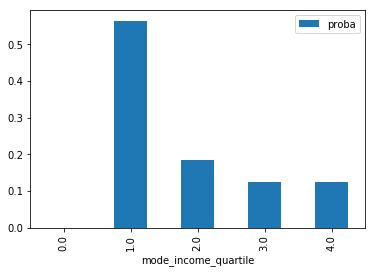

In [173]:
hh_type_ = 1
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#                  'st_zones_population',
                 'st_zones_prop_income_1',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter # The movers in 2016
alts_fit_filters = '(occupied == 0)'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=500,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=500,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)

m.fit(choosers, alternatives, 'hh_spot_id')
m.choosers_predict_filters = segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
proba = printing_results(m, hh_type_, choosers, alternatives)

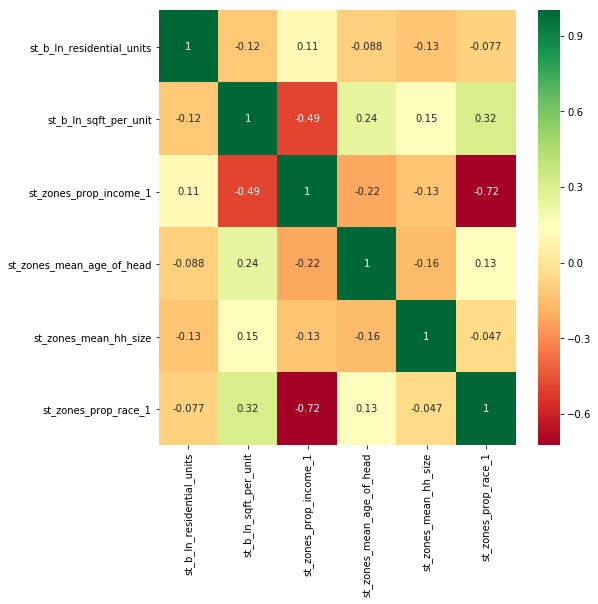

In [174]:
corr_plot(specification)

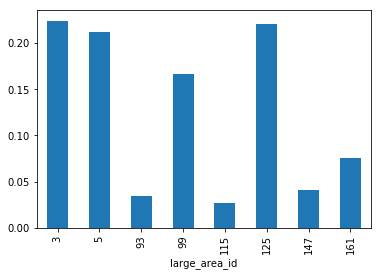

In [175]:
summed_probas('large_area_id', proba, alternatives)

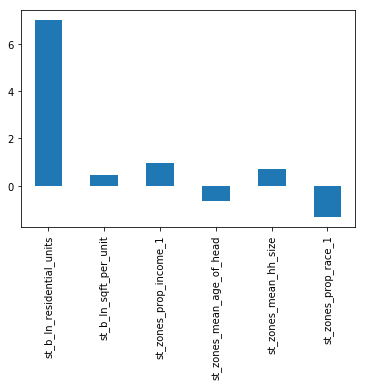

In [176]:
skew_plot(specification)

In [178]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 1_small_midage: 1 or 2 persons AND middle-aged head

Segment: household type = 2
Null Log-liklihood: -6214.608
Log-liklihood at convergence: -6166.636
Log-liklihood Ratio: 0.008

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.024   |   0.009    |  -2.729 |
| st_b_ln_sqft_per_unit     |    -0.192   |   0.129    |  -1.487 |
| st_zones_prop_income_1    |    0.066    |   0.028    |  2.371  |
| st_zones_mean_hh_size     |    -0.300   |   0.034    |  -8.835 |
| st_zones_prop_race_4      |    0.002    |   0.031    |  0.062  |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.030805
summed_proba             -0.030805      1.000000
Prediction R2: -2104.182373787399
-1.2164313549140466
Euclidean distance: 1.14669832738
MSE: 6.4127968190

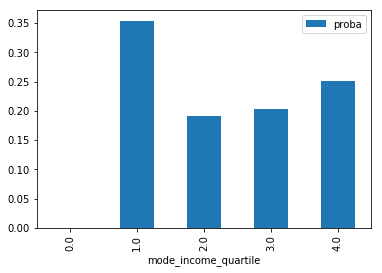

In [179]:
hh_type_ = 2
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
                 'st_zones_prop_income_1',
#                  'st_zones_prop_hh_with_children',
                 'st_zones_mean_hh_size',
                'st_zones_prop_race_4',
#                 'st_zones_prop_retail_buildings'
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter # The movers in 2016
alts_fit_filters = '(occupied == 0)'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=500,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=1000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)

m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

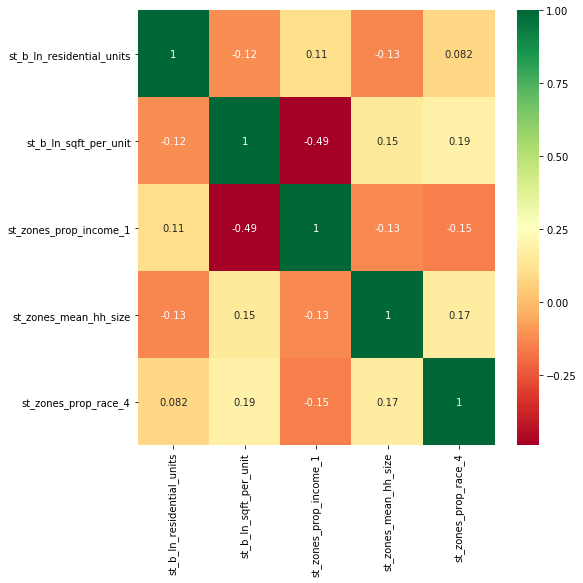

In [180]:
corr_plot(specification)

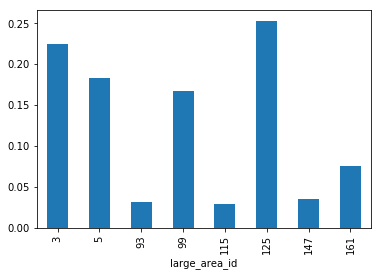

In [181]:
summed_probas('large_area_id', proba, alternatives)

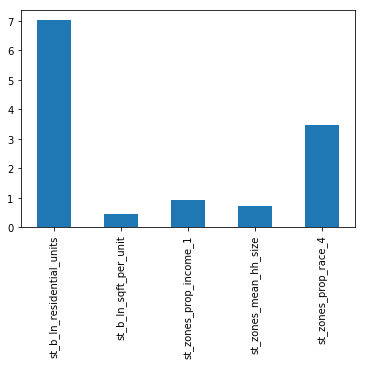

In [182]:
skew_plot(specification)

In [183]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 1_small_young: 1 or 2 persons AND YOUNG head

Segment: household type = 3
Null Log-liklihood: -6214.608
Log-liklihood at convergence: -5805.308
Log-liklihood Ratio: 0.066

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    0.024    |   0.008    |  2.978  |
| st_b_ln_sqft_per_unit     |    -0.578   |   0.151    |  -3.837 |
| st_zones_prop_income_1    |    0.302    |   0.041    |  7.410  |
| st_zones_mean_age_of_head |    -0.302   |   0.023    | -13.347 |
| st_zones_mean_hh_size     |    -0.303   |   0.035    |  -8.583 |
| st_zones_prop_race_2      |    -0.298   |   0.041    |  -7.234 |
| st_zones_prop_race_3      |    -0.069   |   0.032    |  -2.144 |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.015978
summed_proba        

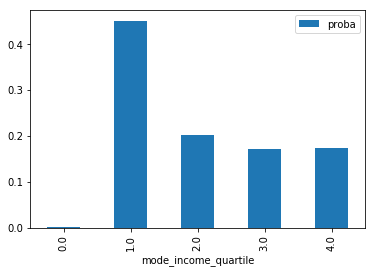

In [184]:
hh_type_ = 3
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#                  'st_jobs_within_30_min',
#                  'st_zones_sum_residential_units',
#                  'st_zones_households',
                 'st_zones_prop_income_1',
#         'st_zones_prop_income_4',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                'st_zones_prop_race_2',
        'st_zones_prop_race_3',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = '(occupied == 0)'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=500,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=1000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

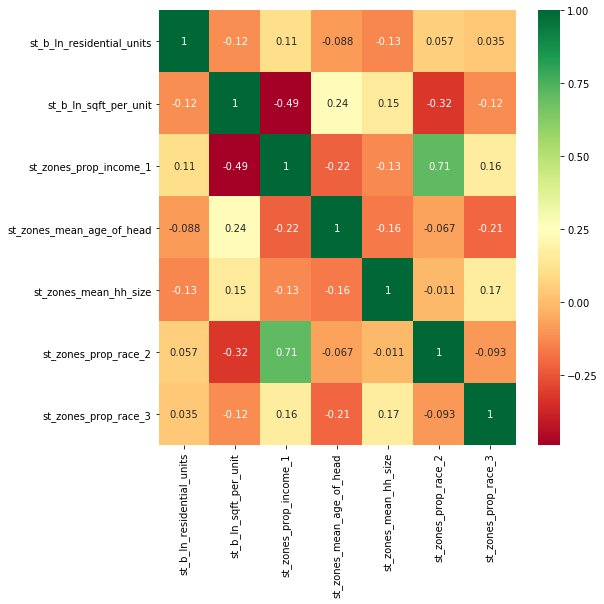

In [185]:
corr_plot(specification)

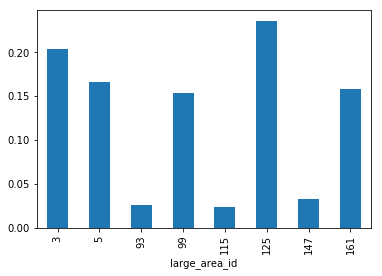

In [186]:
summed_probas('large_area_id', proba, alternatives)

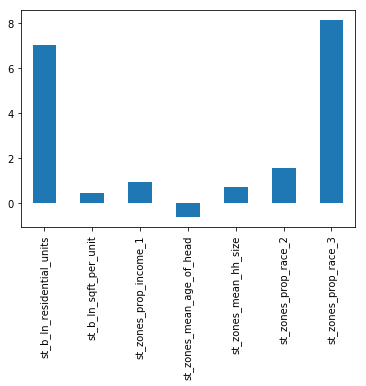

In [187]:
skew_plot(specification)

In [188]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 1_big_senior: more than 2 persons AND senior head

Segment: household type = 4
Null Log-liklihood: -3281.313
Log-liklihood at convergence: -3266.005
Log-liklihood Ratio: 0.005

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.016   |   0.010    |  -1.518 |
| st_b_ln_sqft_per_unit     |    0.326    |   0.167    |  1.954  |
| st_zones_prop_income_1    |    0.324    |   0.051    |  6.343  |
| st_zones_prop_race_1      |    0.265    |   0.050    |  5.278  |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.015674
summed_proba             -0.015674      1.000000
Prediction R2: -6026.926787391299
-0.29520513691164374
Euclidean distance: 1.87882555374
MSE: 1.7215595059251151e-06


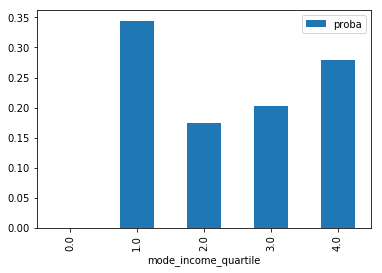

In [189]:
hh_type_ = 4
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#                  'st_zones_population',
                 'st_zones_prop_income_1',
#                  'st_zones_mean_age_of_head',
#                  'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
#     'st_zones_prop_office_buildings'
                ]
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = '(occupied == 0)'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=500,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=1000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

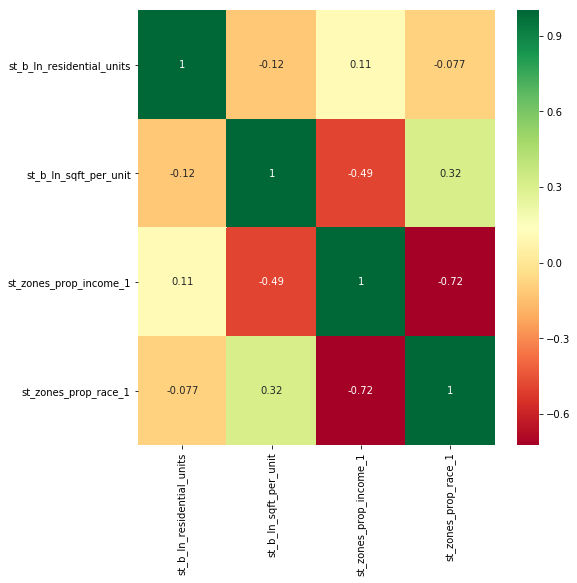

In [190]:
corr_plot(specification)

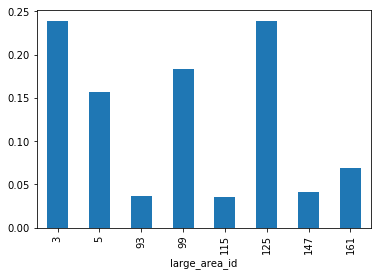

In [191]:
summed_probas('large_area_id', proba, alternatives)

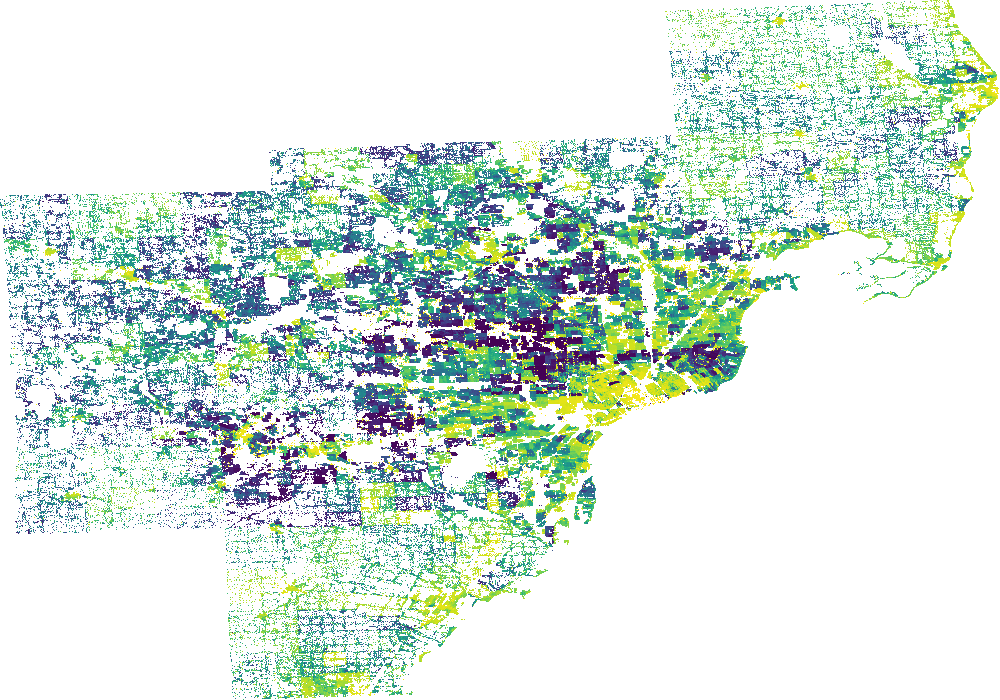

In [192]:
plot_probas(proba, alternatives)

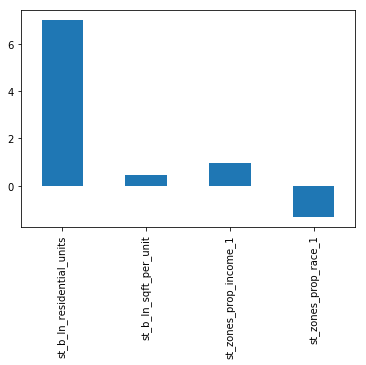

In [193]:
skew_plot(specification)

In [194]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 1_big_midage: more than 2 persons AND middle-aged head

Segment: household type = 5
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -13523.181
Log-liklihood Ratio: 0.021

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.063   |   0.007    |  -8.564 |
| st_zones_households            |    0.151    |   0.023    |  6.524  |
| st_zones_prop_income_1         |    0.429    |   0.025    |  16.853 |
| st_zones_prop_hh_with_children |    0.151    |   0.038    |  3.999  |
| st_zones_mean_hh_size          |    0.079    |   0.033    |  2.377  |
| st_zones_prop_race_2           |    -0.371   |   0.025    | -14.605 |
+--------------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.019429
summed_proba             -0.019429 

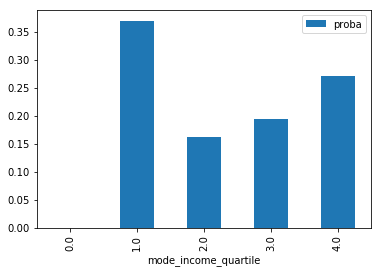

In [195]:
hh_type_ = 5
segment_filter = 'household_type == {}'.format(hh_type_)
specification = ['st_b_ln_residential_units',
#                  'st_b_ln_sqft_per_unit',
#                  'st_jobs_within_30_min',
                 'st_zones_households',
                 'st_zones_prop_income_1',
                 'st_zones_prop_hh_with_children',
                 'st_zones_mean_hh_size',
                'st_zones_prop_race_2',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

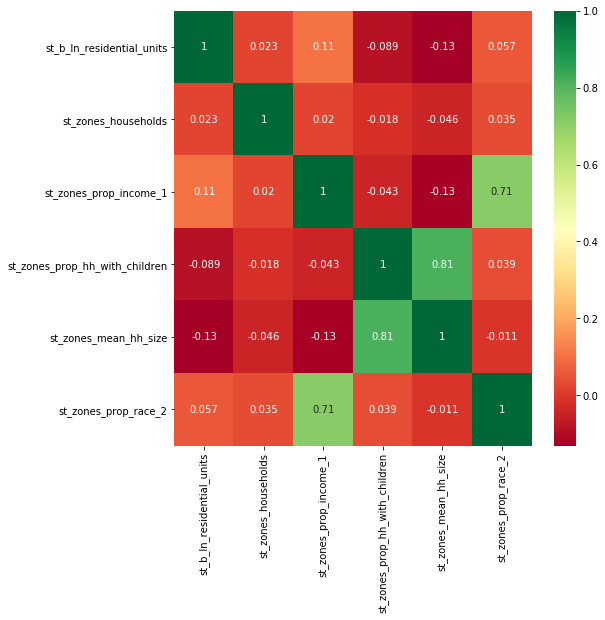

In [196]:
corr_plot(specification)

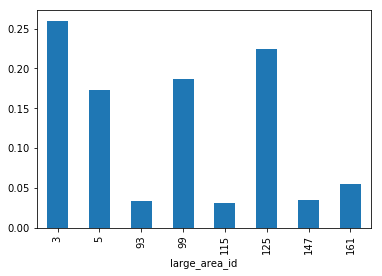

In [197]:
summed_probas('large_area_id', proba, alternatives)

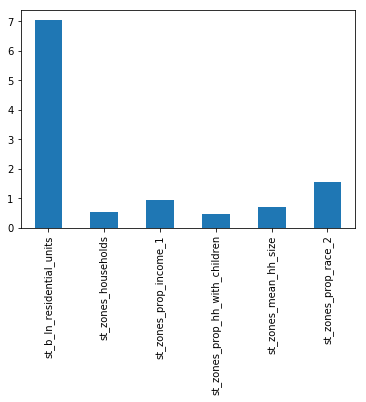

In [198]:
skew_plot(specification)

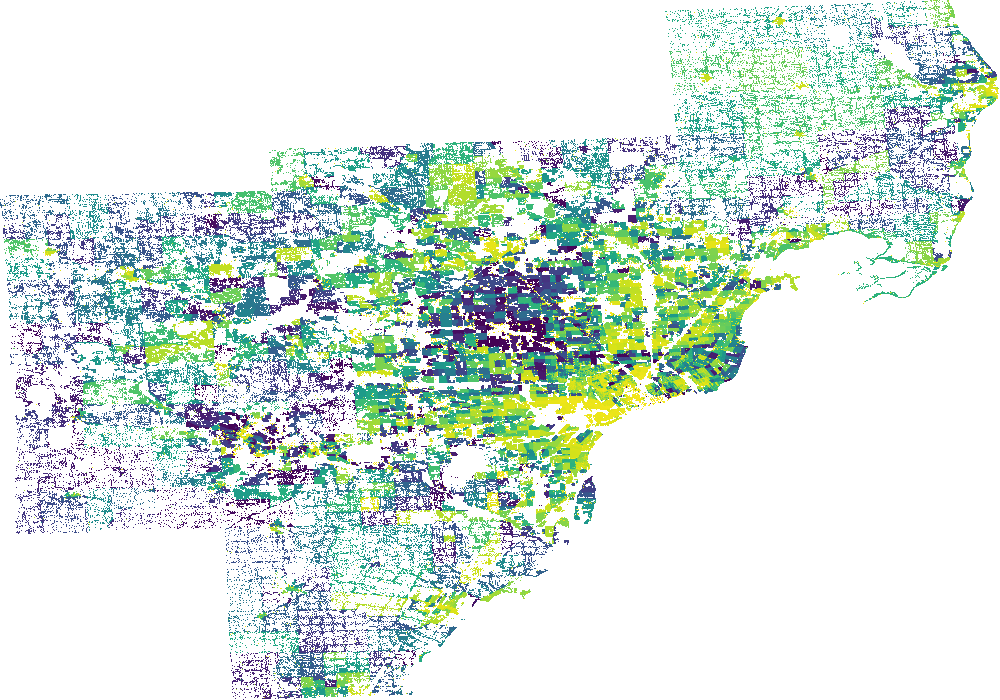

In [199]:
plot_probas(proba, alternatives)

In [200]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 1_big_young: more than 2 persons AND YOUNG head

Segment: household type = 6
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -13301.574
Log-liklihood Ratio: 0.037

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.012   |   0.007    |  -1.728 |
| st_jobs_within_30_min     |    -0.293   |   0.030    |  -9.803 |
| st_zones_ln_empden        |    0.101    |   0.022    |  4.490  |
| st_zones_prop_income_1    |    0.304    |   0.024    |  12.775 |
| st_zones_mean_age_of_head |    -0.341   |   0.022    | -15.168 |
| st_zones_mean_hh_size     |    0.185    |   0.021    |  8.969  |
| st_zones_prop_race_4      |    0.019    |   0.020    |  0.931  |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.016318
summed_proba      

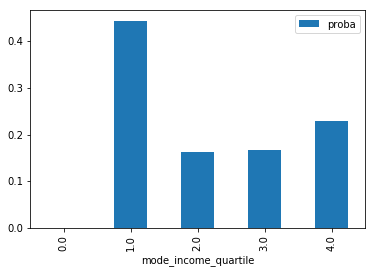

In [201]:
hh_type_ = 6
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
#                  'st_b_ln_sqft_per_unit',
                 'st_jobs_within_30_min',
#                  'st_zones_population',
                 'st_zones_ln_empden',
                 'st_zones_prop_income_1',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
#                 'st_zones_prop_hh_with_children',
                 'st_zones_prop_race_4',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

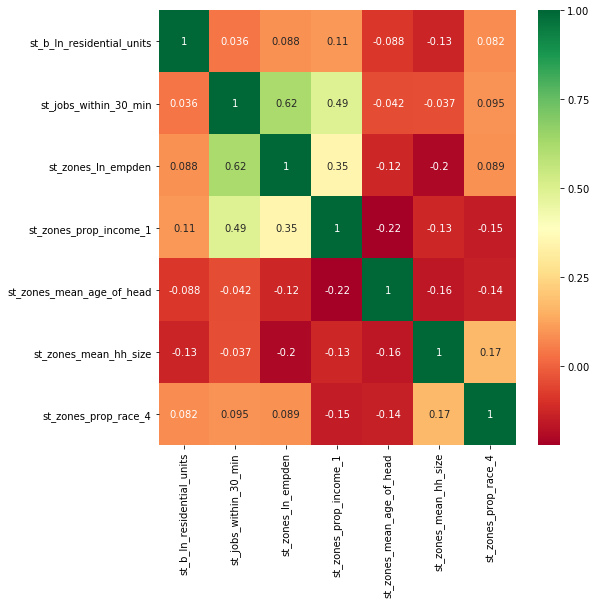

In [202]:
corr_plot(specification)

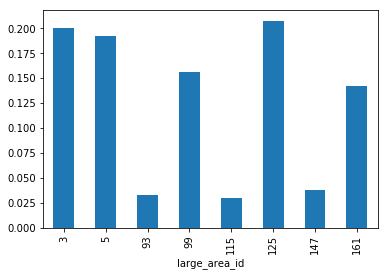

In [203]:
summed_probas('large_area_id', proba, alternatives)

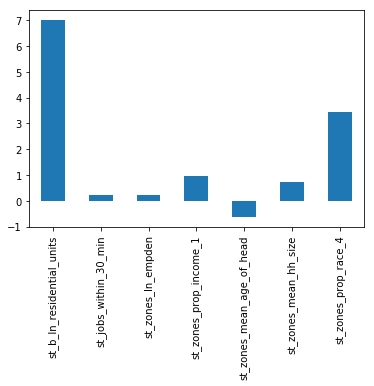

In [204]:
skew_plot(specification)

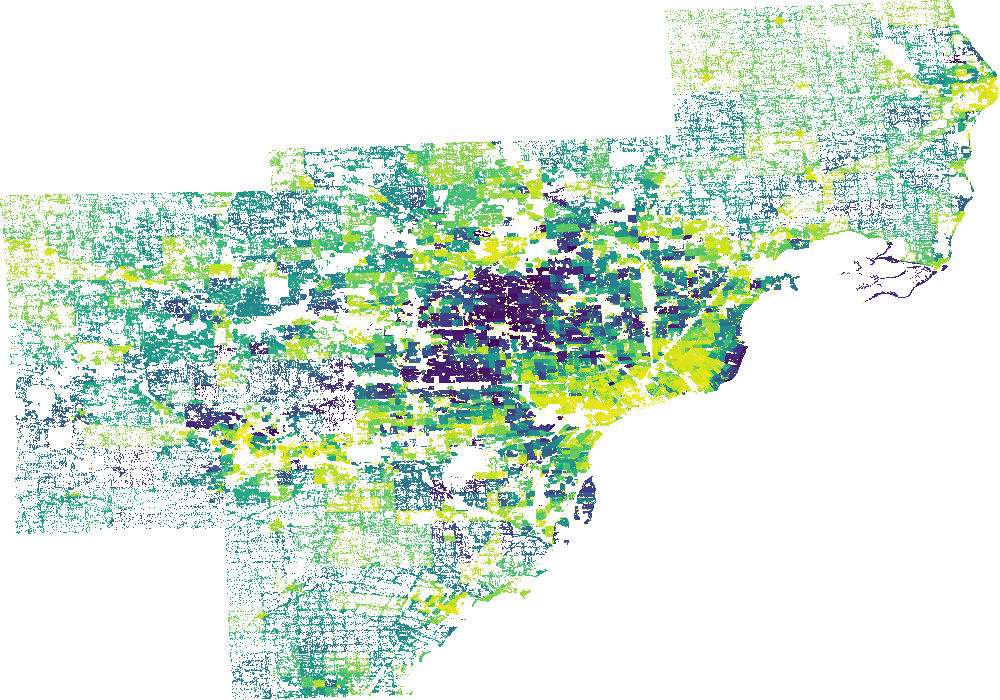

In [205]:
plot_probas(proba, alternatives)

In [206]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

## B - Middle Income
### 23_small_senior : 1 or 2 persons AND senior head

Segment: household type = 7
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -13211.777
Log-liklihood Ratio: 0.044

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.057   |   0.008    |  -7.564 |
| st_b_ln_sqft_per_unit     |    0.862    |   0.074    |  11.591 |
| st_zones_prop_income_3    |    0.155    |   0.028    |  5.495  |
| st_zones_prop_income_2    |    0.226    |   0.024    |  9.294  |
| st_zones_mean_age_of_head |    0.284    |   0.029    |  9.833  |
| st_zones_prop_race_1      |    0.393    |   0.116    |  3.385  |
| st_zones_prop_race_2      |    -0.056   |   0.116    |  -0.478 |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.036523
summed_proba      

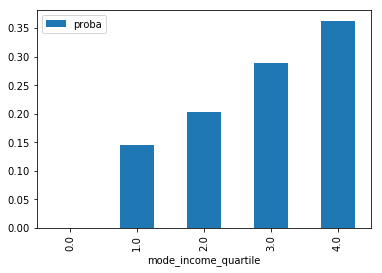

In [207]:
hh_type_ = 7
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
                 'st_zones_prop_income_3',
        'st_zones_prop_income_2',
                 'st_zones_mean_age_of_head',
#                  'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                'st_zones_prop_race_2',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

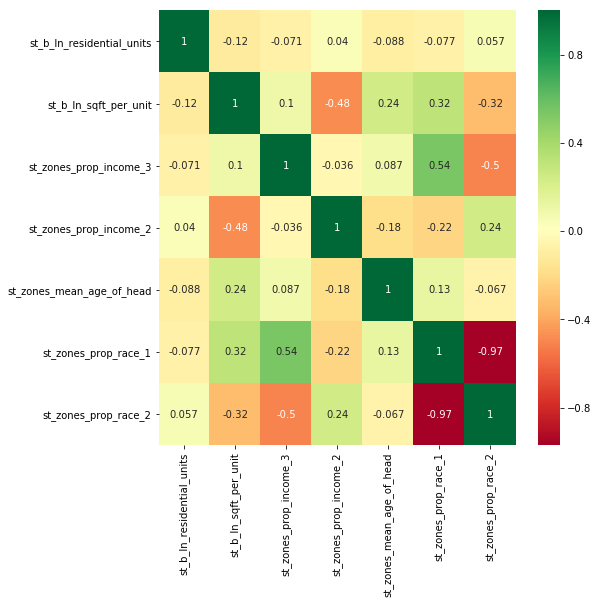

In [208]:
corr_plot(specification)

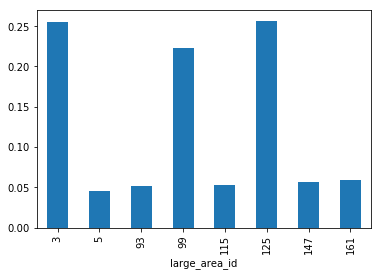

In [209]:
summed_probas('large_area_id', proba, alternatives)

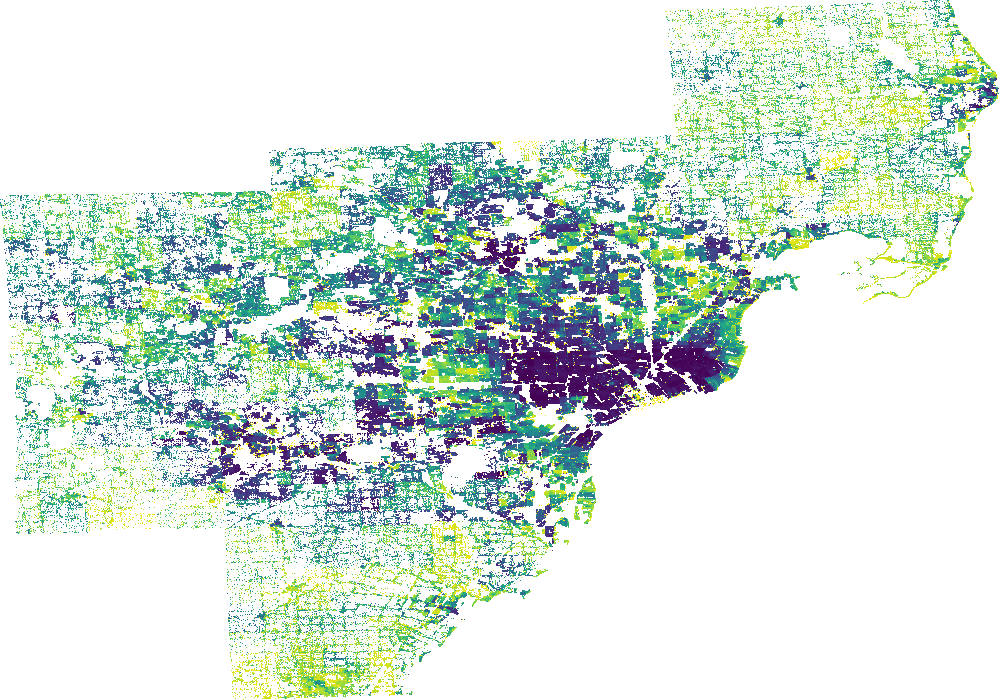

In [210]:
plot_probas(proba, alternatives)

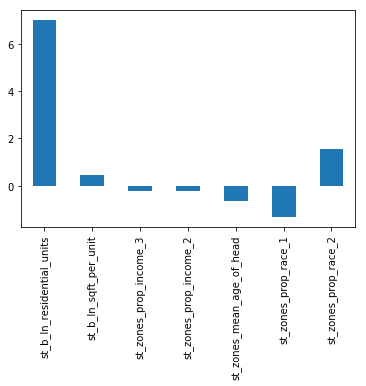

In [211]:
skew_plot(specification)

In [212]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 23_small_midage: 1 or 2 persons AND middle-aged head

Segment: household type = 8
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -13428.033
Log-liklihood Ratio: 0.028

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.039   |   0.007    |  -5.420 |
| st_b_ln_sqft_per_unit     |    0.464    |   0.082    |  5.691  |
| st_zones_prop_income_3    |    0.327    |   0.028    |  11.604 |
| st_zones_prop_income_2    |    0.177    |   0.026    |  6.722  |
| st_zones_mean_hh_size     |    -0.252   |   0.028    |  -9.082 |
| st_zones_prop_race_1      |    0.213    |   0.029    |  7.207  |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.042592
summed_proba             -0.042592      1.000000
Prediction R2: -1389.0253504057139
-

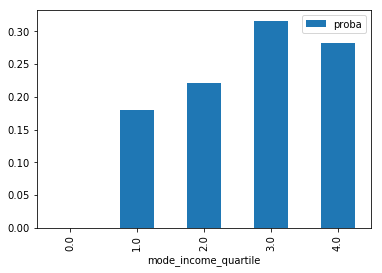

In [213]:
hh_type_ = 8
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#                 'st_zones_z_total_jobs',
#                 'st_zones_population',
                 'st_zones_prop_income_3',
                'st_zones_prop_income_2',
#                  'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

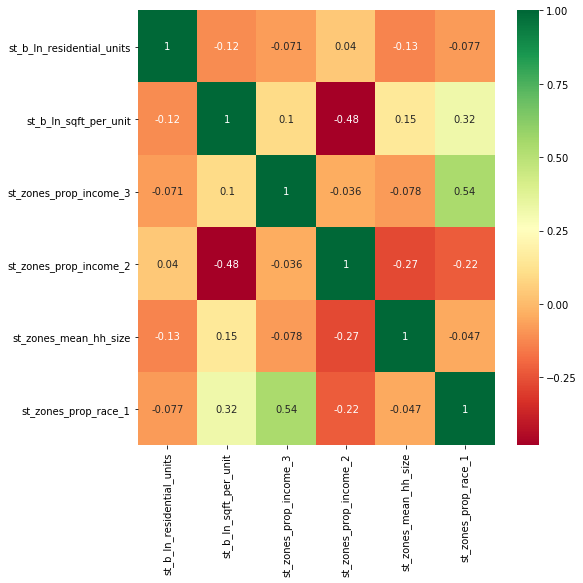

In [214]:
corr_plot(specification)

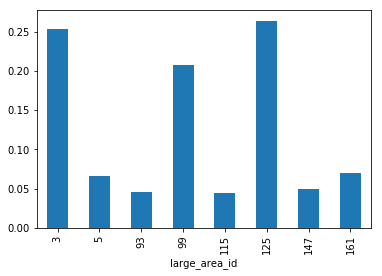

In [215]:
summed_probas('large_area_id', proba, alternatives)

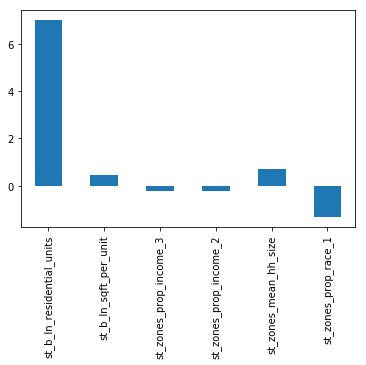

In [216]:
skew_plot(specification)

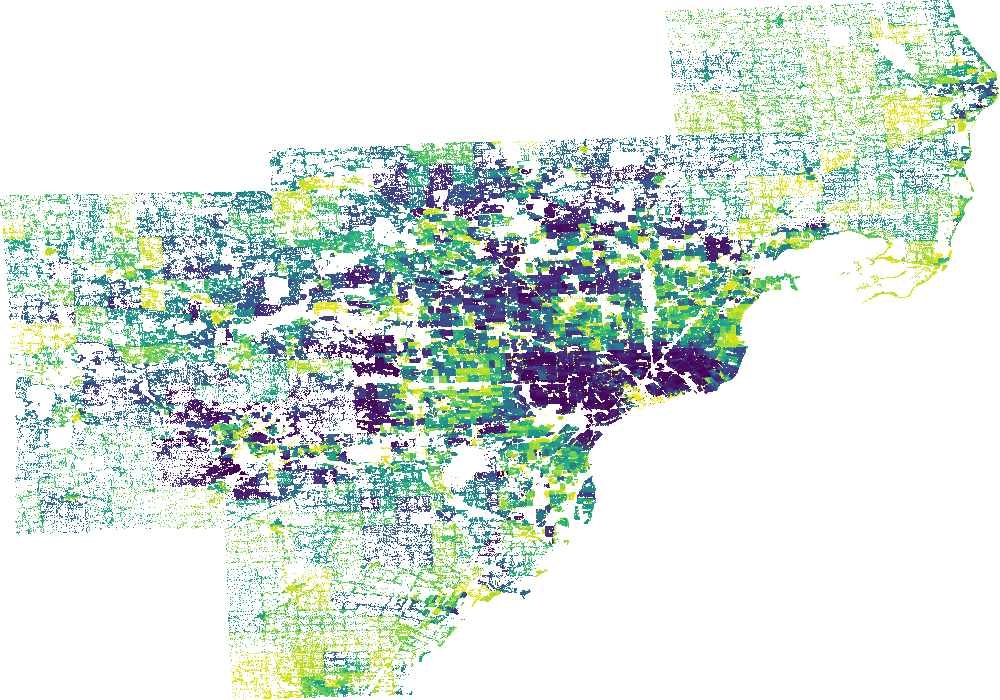

In [217]:
plot_probas(proba, alternatives)

In [218]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 23_small_young: 1 or 2 persons AND YOUNG head

Segment: household type = 9
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -12981.382
Log-liklihood Ratio: 0.060

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    0.038    |   0.006    |  6.167  |
| st_b_ln_sqft_per_unit     |    0.132    |   0.101    |  1.307  |
| st_zones_households       |    0.134    |   0.021    |  6.414  |
| st_zones_prop_income_3    |    0.249    |   0.027    |  9.303  |
| st_zones_prop_income_2    |    0.171    |   0.026    |  6.544  |
| st_zones_mean_age_of_head |    -0.305   |   0.019    | -16.399 |
| st_zones_mean_hh_size     |    -0.386   |   0.028    | -13.898 |
| st_zones_prop_race_1      |    0.362    |   0.032    |  11.268 |
| st_zones_prop_race_3      |    0.003    |   0.033    |  0.094  |
+---------------------------+-------------+------------+---------+
N

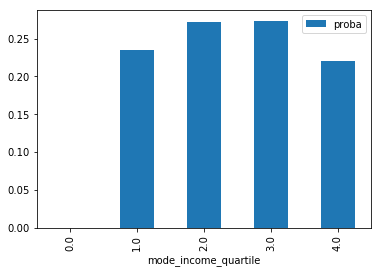

In [219]:
hh_type_ = 9
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#                 'st_zones_empden',
                'st_zones_households',
                 'st_zones_prop_income_3',
                'st_zones_prop_income_2',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
    'st_zones_prop_race_3',
                ]
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

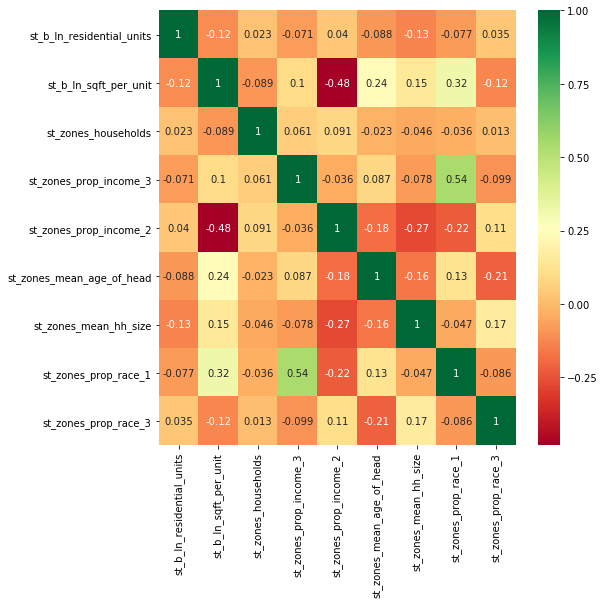

In [220]:
corr_plot(specification)

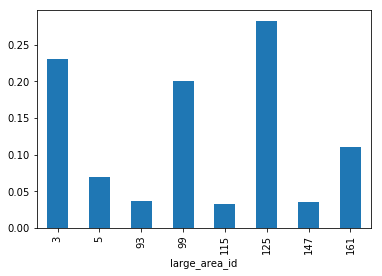

In [221]:
summed_probas('large_area_id', proba, alternatives)

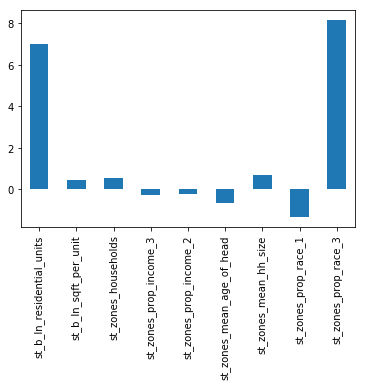

In [222]:
skew_plot(specification)

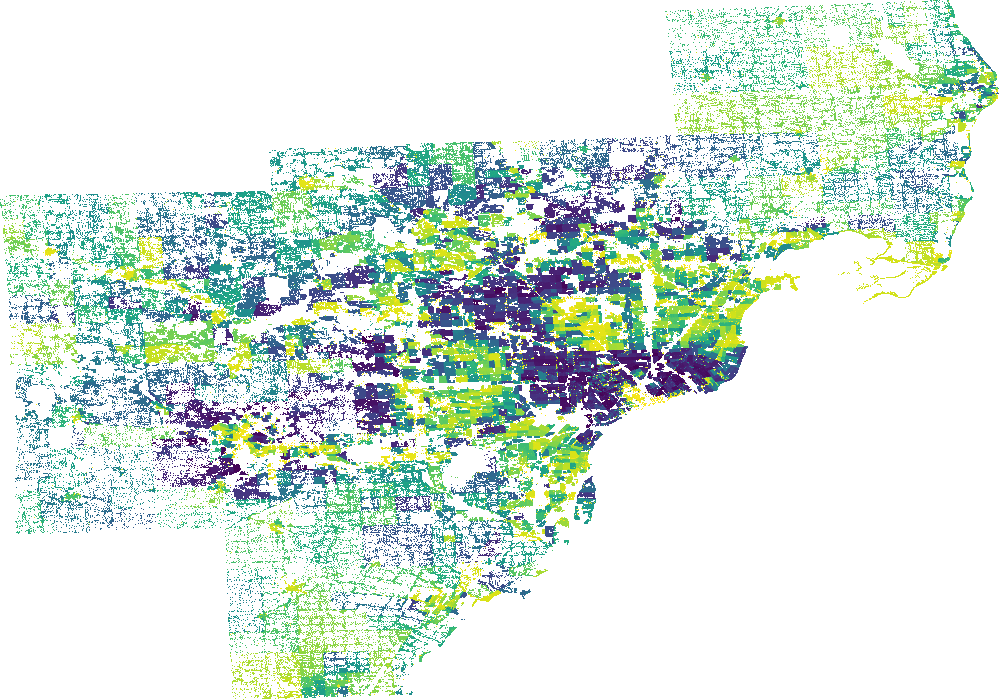

In [223]:
plot_probas(proba, alternatives)

In [224]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 23_big_senior: more than 2 persons AND senior head

Segment: household type = 10
Null Log-liklihood: -12889.871
Log-liklihood at convergence: -12383.469
Log-liklihood Ratio: 0.039

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.130   |   0.011    | -12.312 |
| st_b_ln_sqft_per_unit     |    0.826    |   0.080    |  10.284 |
| st_zones_prop_income_3    |    0.342    |   0.034    |  10.187 |
| st_zones_prop_income_1    |    0.065    |   0.042    |  1.550  |
| st_zones_mean_age_of_head |    0.459    |   0.033    |  14.031 |
| st_zones_mean_hh_size     |    0.103    |   0.026    |  3.979  |
| st_zones_prop_race_1      |    -0.015   |   0.030    |  -0.485 |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.026806
summed_proba     

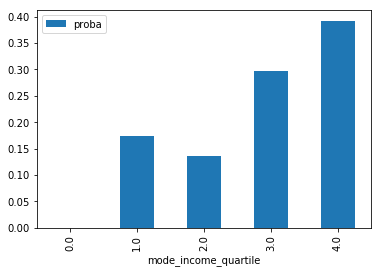

In [225]:
hh_type_ = 10
segment_filter = 'household_type == {}'.format(hh_type_)
specification =  [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#                 'st_jobs_within_30_min',
                 'st_zones_prop_income_3',
                'st_zones_prop_income_1',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

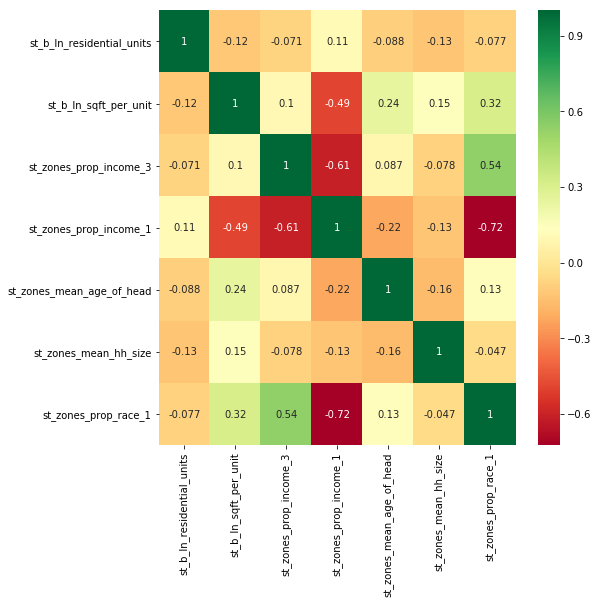

In [226]:
corr_plot(specification)

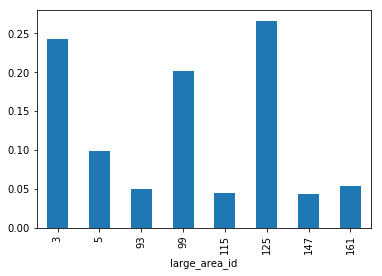

In [227]:
summed_probas('large_area_id', proba, alternatives)

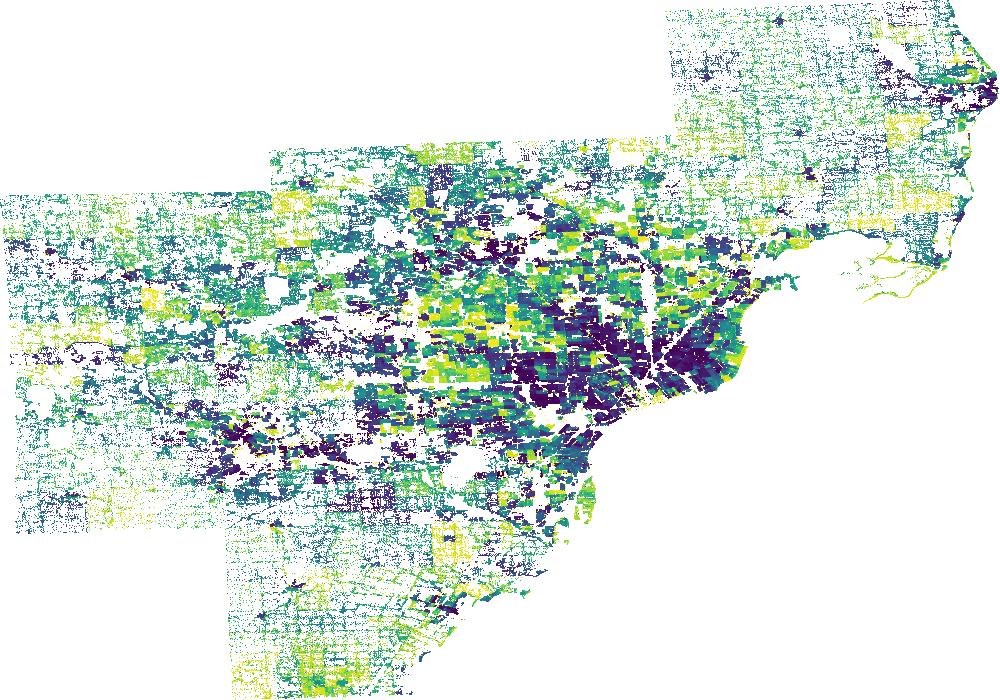

In [228]:
plot_probas(proba, alternatives)

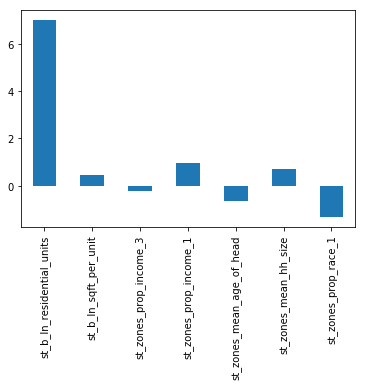

In [229]:
skew_plot(specification)

In [230]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 23_big_midage: more than 2 persons AND middle-aged head

Segment: household type = 11
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -13267.547
Log-liklihood Ratio: 0.040

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.110   |   0.009    | -11.683 |
| st_b_ln_sqft_per_unit          |    0.920    |   0.076    |  12.054 |
| st_zones_prop_income_3         |    0.505    |   0.025    |  20.238 |
| st_zones_prop_income_2         |    0.224    |   0.024    |  9.162  |
| st_zones_prop_hh_with_children |    0.195    |   0.024    |  8.189  |
+--------------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.040087
summed_proba             -0.040087      1.000000
Prediction R2: -1354.467056208841
-2.3535860622658737
Euc

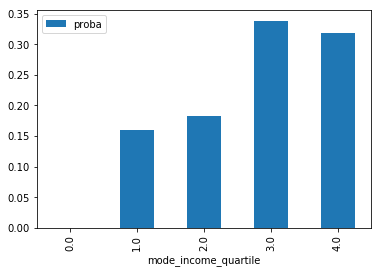

In [231]:
hh_type_ = 11
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#             'st_zones_prop_retail_buildings',
                 'st_zones_prop_income_3',
                'st_zones_prop_income_2',
            'st_zones_prop_hh_with_children',
#                  'st_zones_mean_hh_size',
#                  'st_zones_prop_race_1',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

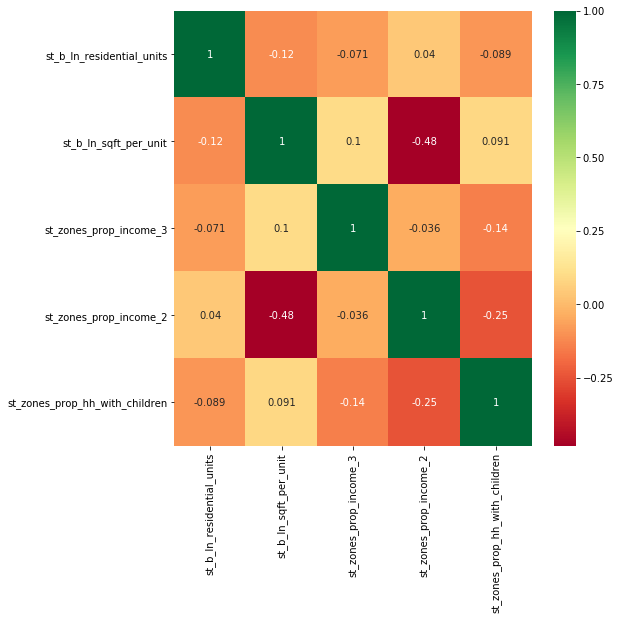

In [232]:
corr_plot(specification)

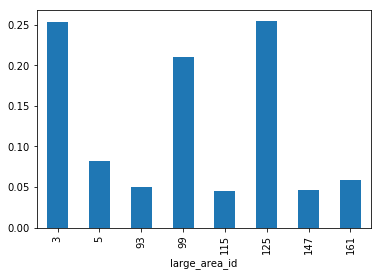

In [233]:
summed_probas('large_area_id', proba, alternatives)

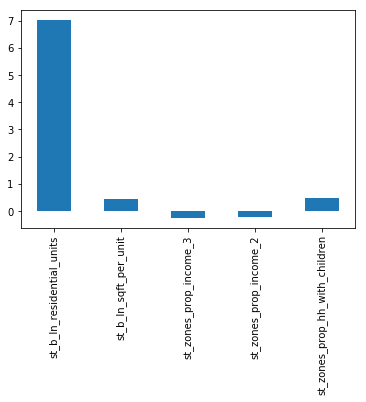

In [234]:
skew_plot(specification)

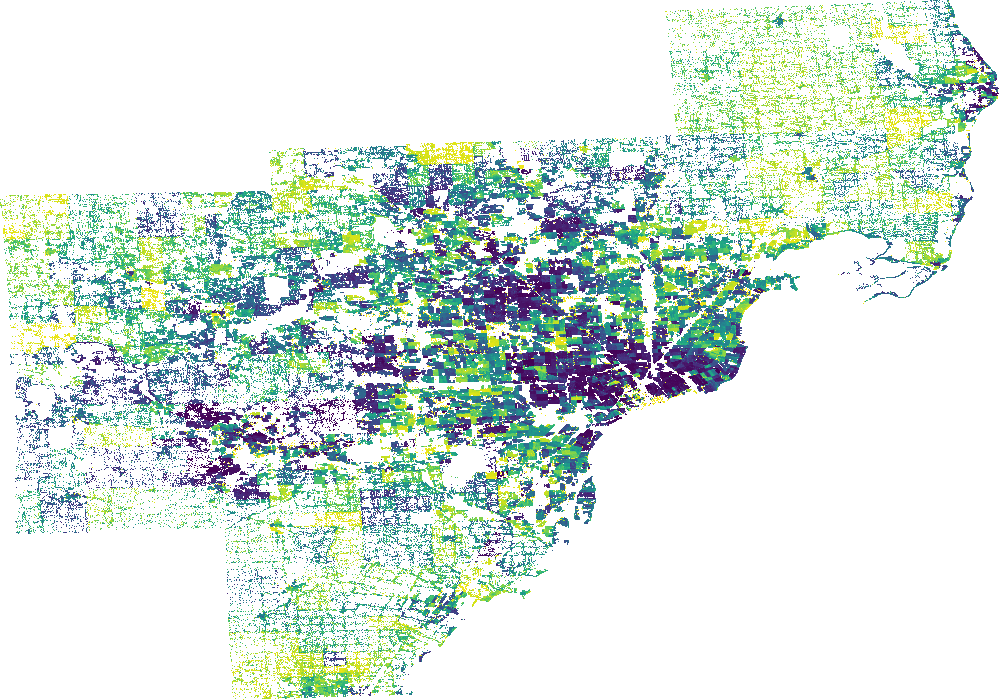

In [235]:
plot_probas(proba, alternatives)

In [236]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 23_big_young: more than 2 persons AND YOUNG head

Segment: household type = 12
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -13260.849
Log-liklihood Ratio: 0.040

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.047   |   0.007    |  -6.873 |
| st_zones_popden                |    0.167    |   0.016    |  10.448 |
| st_zones_prop_income_3         |    0.121    |   0.028    |  4.346  |
| st_zones_prop_income_2         |    0.273    |   0.025    |  10.772 |
| st_zones_prop_hh_with_children |    -0.001   |   0.021    |  -0.035 |
| st_zones_prop_race_1           |    0.682    |   0.034    |  20.325 |
+--------------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.032628
summed_proba             -0.032628

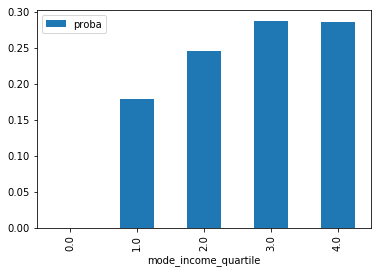

In [237]:
hh_type_ = 12
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
#                  'st_b_ln_sqft_per_unit',
                'st_zones_popden',
#                 'st_zones_prop_retail_buildings',
                 'st_zones_prop_income_3',
                'st_zones_prop_income_2',
                'st_zones_prop_hh_with_children',
#                  'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

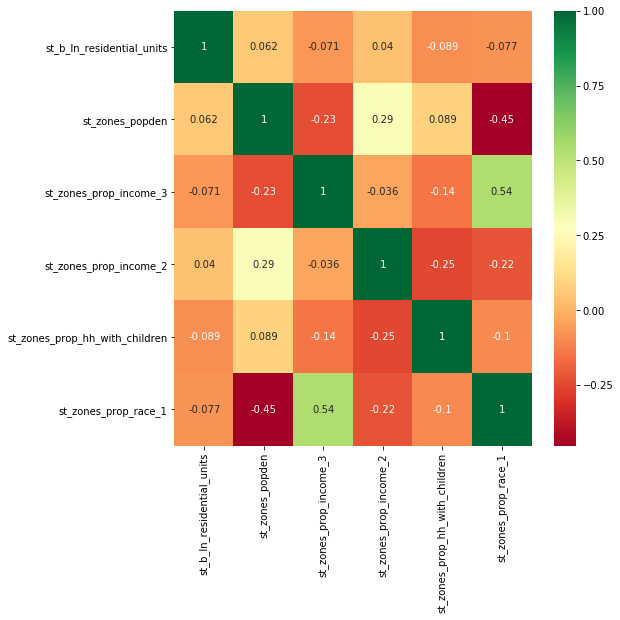

In [238]:
corr_plot(specification)

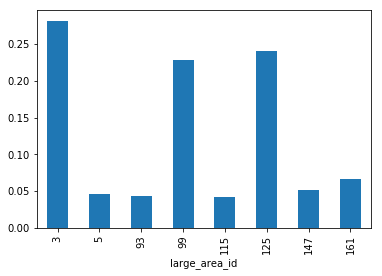

In [239]:
summed_probas('large_area_id', proba, alternatives)

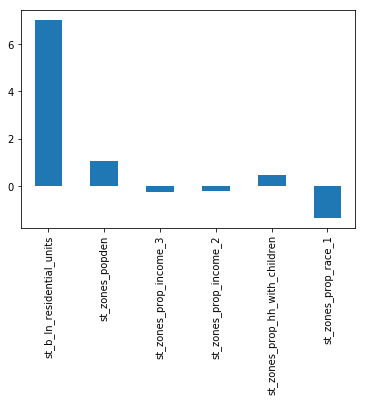

In [240]:
skew_plot(specification)

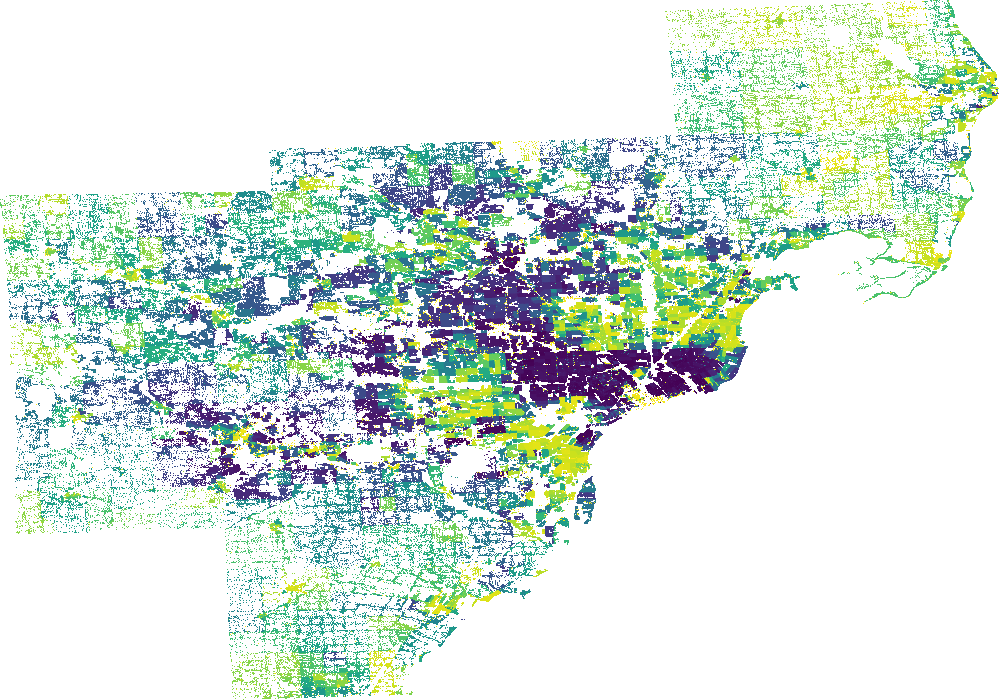

In [241]:
plot_probas(proba, alternatives)

In [242]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

## C - High Income
### 4_small_senior : 1 or 2 persons AND senior head

Segment: household type = 13
Null Log-liklihood: -3384.800
Log-liklihood at convergence: -2903.853
Log-liklihood Ratio: 0.142

+---------------------------+-------------+------------+---------+
| Component                 | Coefficient | Std. Error | T-Score |
+---------------------------+-------------+------------+---------+
| st_b_ln_residential_units |    -0.174   |   0.021    |  -8.244 |
| st_b_ln_sqft_per_unit     |    1.044    |   0.139    |  7.490  |
| st_zones_prop_income_4    |    1.068    |   0.050    |  21.346 |
| st_zones_mean_age_of_head |    0.039    |   0.044    |  0.892  |
| st_zones_mean_hh_size     |    -0.922   |   0.057    | -16.309 |
+---------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.015735
summed_proba             -0.015735      1.000000
Prediction R2: -925.1870403524259
-0.7122299003067489
Euclidean distance: 1.13845040783
MSE: 6.320877243

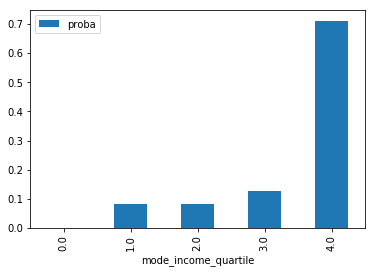

In [243]:
hh_type_ = 13
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
#     'st_parcels_max_height' ,
#                 'st_zones_prop_residential_buildings',
#                 'st_zones_ln_popden',
                'st_zones_prop_income_4',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
#                  'st_zones_prop_race_1',
                ] 
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

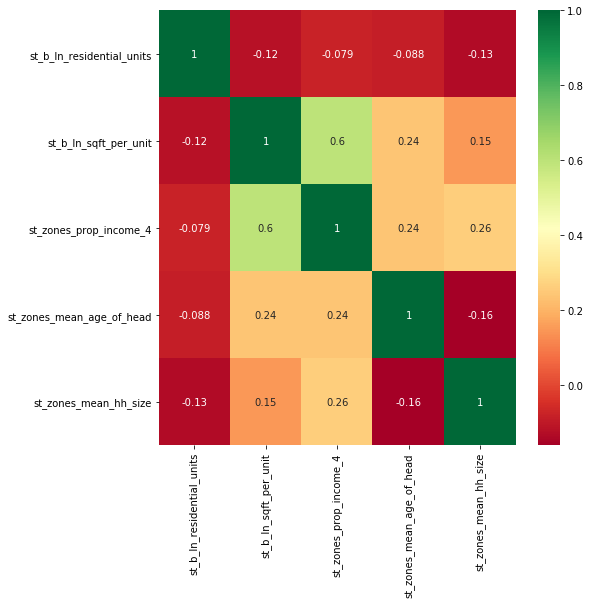

In [244]:
corr_plot(specification)

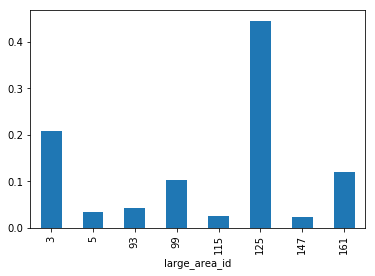

In [245]:
summed_probas('large_area_id', proba, alternatives)

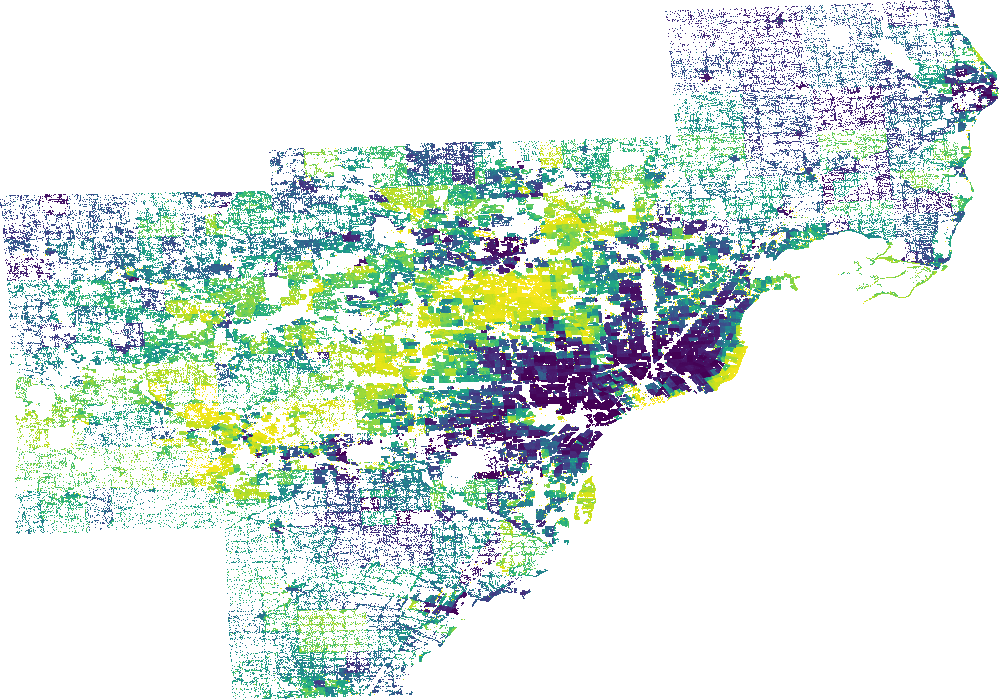

In [246]:
plot_probas(proba, alternatives)

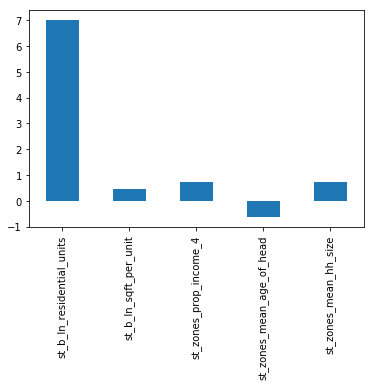

In [247]:
skew_plot(specification)

In [248]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 4_small_midage: 1 or 2 persons AND middle-aged head

Segment: household type = 14
Null Log-liklihood: -8420.554
Log-liklihood at convergence: -7551.595
Log-liklihood Ratio: 0.103

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.105   |   0.012    |  -8.686 |
| st_b_ln_sqft_per_unit          |    0.968    |   0.102    |  9.535  |
| st_zones_sum_residential_units |    -0.019   |   0.026    |  -0.730 |
| st_zones_prop_income_4         |    0.705    |   0.041    |  17.339 |
| st_zones_mean_hh_size          |    -0.498   |   0.039    | -12.901 |
| st_zones_prop_race_1           |    0.484    |   0.051    |  9.528  |
+--------------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_distrib          1.000000     -0.023724
summed_proba             -0.023724  

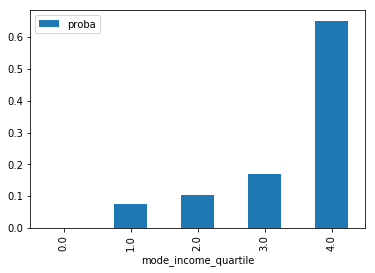

In [250]:
hh_type_ = 14
segment_filter = 'household_type == {}'.format(hh_type_)
specification = ['st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
                'st_zones_sum_residential_units',
                'st_zones_prop_income_4',
#                  'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ]
choosers_fit_filters = "(building_id_16  == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

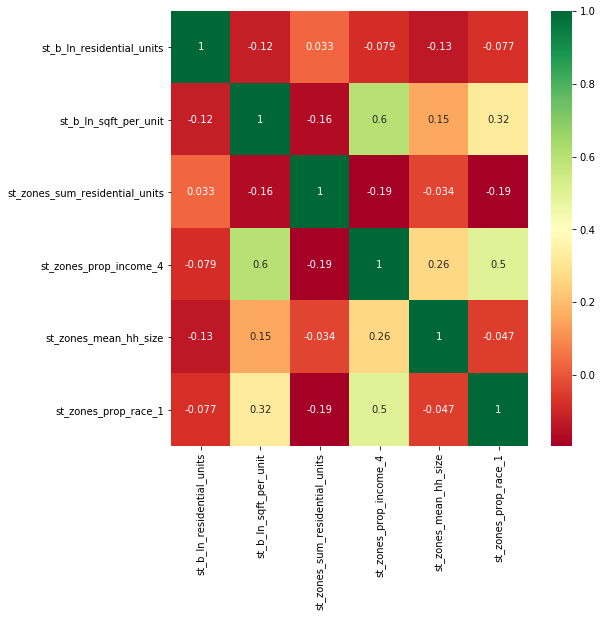

In [251]:
corr_plot(specification)

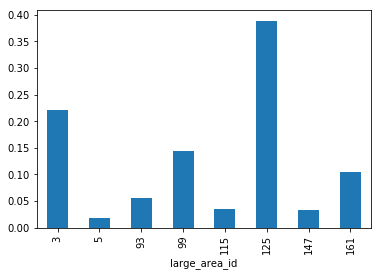

In [252]:
summed_probas('large_area_id', proba, alternatives)

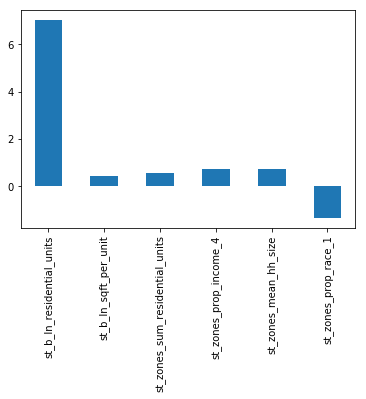

In [253]:
skew_plot(specification)

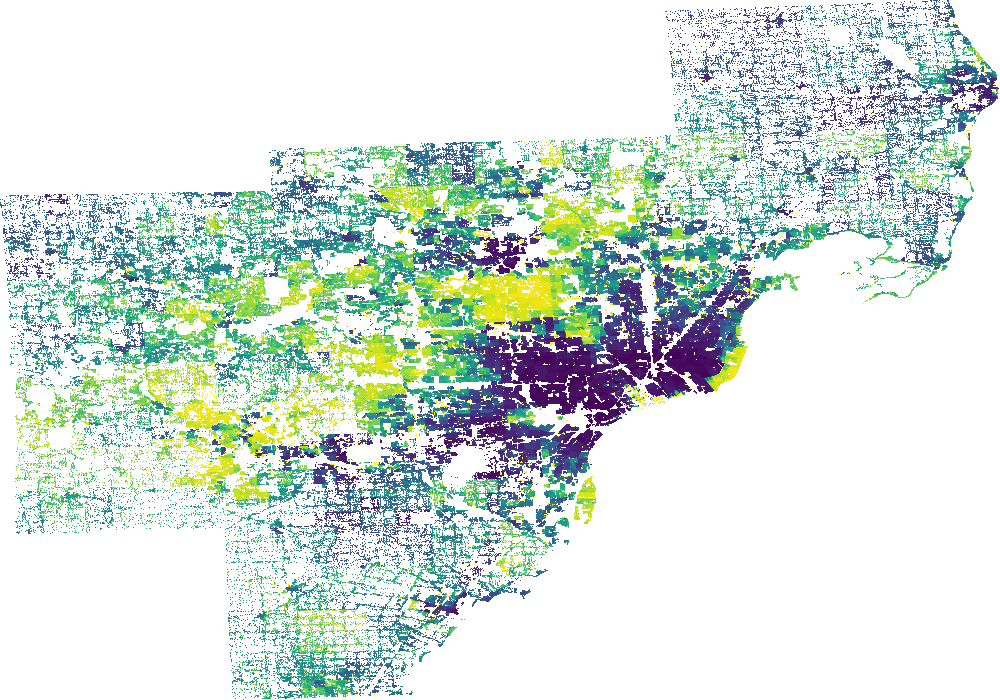

In [254]:
plot_probas(proba, alternatives)

In [255]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 4_small_young: 1 or 2 persons AND YOUNG head

Segment: household type = 15
Null Log-liklihood: -3868.343
Log-liklihood at convergence: -3598.700
Log-liklihood Ratio: 0.070

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.023   |   0.012    |  -1.827 |
| st_b_ln_sqft_per_unit          |    0.546    |   0.157    |  3.467  |
| st_zones_sum_residential_units |    0.045    |   0.041    |  1.101  |
| st_zones_prop_income_4         |    0.631    |   0.064    |  9.909  |
| st_zones_mean_age_of_head      |    -0.334   |   0.036    |  -9.217 |
| st_zones_mean_hh_size          |    -0.529   |   0.050    | -10.483 |
| st_zones_prop_race_1           |    0.408    |   0.065    |  6.250  |
+--------------------------------+-------------+------------+---------+
None
Correlation:
                   observed_distrib  summed_proba
observed_dist

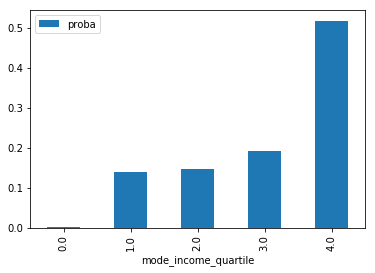

In [256]:
hh_type_ = 15
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
                'st_zones_sum_residential_units',
                'st_zones_prop_income_4',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ]
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

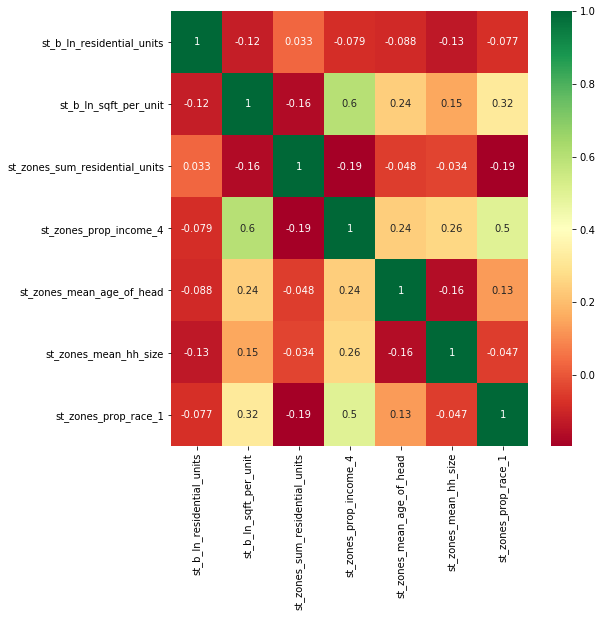

In [257]:
corr_plot(specification)

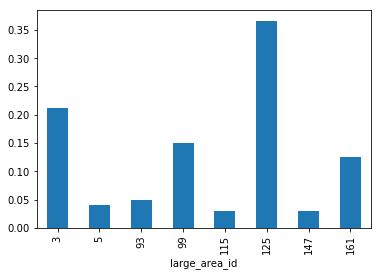

In [258]:
summed_probas('large_area_id', proba, alternatives)

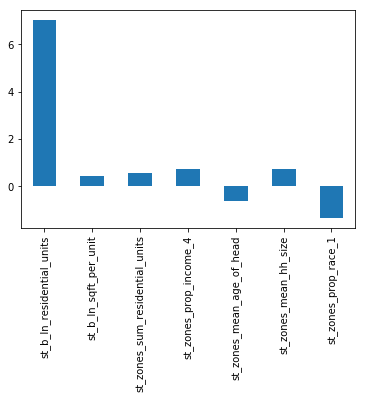

In [259]:
skew_plot(specification)

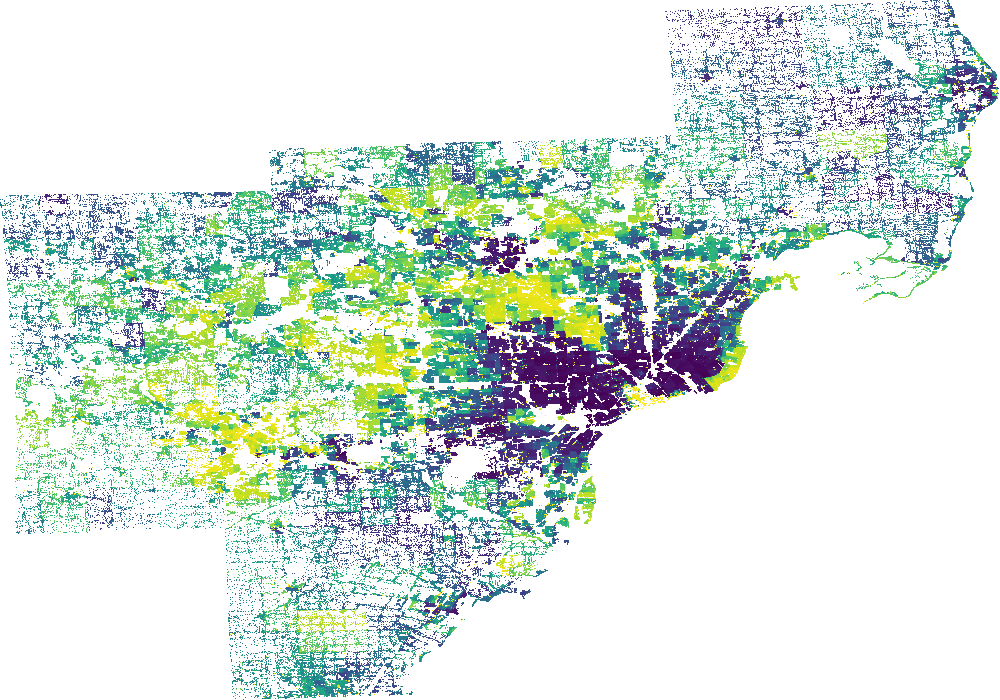

In [260]:
plot_probas(proba, alternatives)

In [261]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 4_big_senior: more than 2 persons AND senior head

Segment: household type = 16
Null Log-liklihood: -4517.672
Log-liklihood at convergence: -4156.483
Log-liklihood Ratio: 0.080

+---------------------------------+-------------+------------+---------+
| Component                       | Coefficient | Std. Error | T-Score |
+---------------------------------+-------------+------------+---------+
| st_b_ln_residential_units       |    0.300    |   0.046    |  6.466  |
| st_b_ln_building_sqft           |    -0.730   |   0.087    |  -8.363 |
| st_b_ln_sqft_per_unit           |    3.000    |   0.149    |  20.186 |
| st_zones_sum_residential_units  |    -0.048   |   0.043    |  -1.114 |
| st_zones_prop_income_4          |    0.427    |   0.055    |  7.715  |
| st_zones_mean_age_of_head       |    0.361    |   0.049    |  7.424  |
| st_zones_logsum_pop_high_income |    0.034    |   0.051    |  0.675  |
| st_zones_mean_hh_size           |    -0.033   |   0.054    |  -0.614 |
| st_zones_prop_race_1            |    0.120    |   0.059    |  2.021 

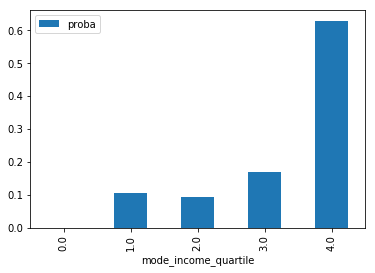

In [262]:
hh_type_ = 16
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                'st_b_ln_building_sqft',
                 'st_b_ln_sqft_per_unit',
                'st_zones_sum_residential_units',
                'st_zones_prop_income_4',
                 'st_zones_mean_age_of_head',
                'st_zones_logsum_pop_high_income',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ]
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

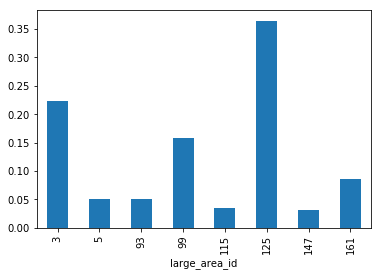

In [263]:
summed_probas('large_area_id', proba, alternatives)

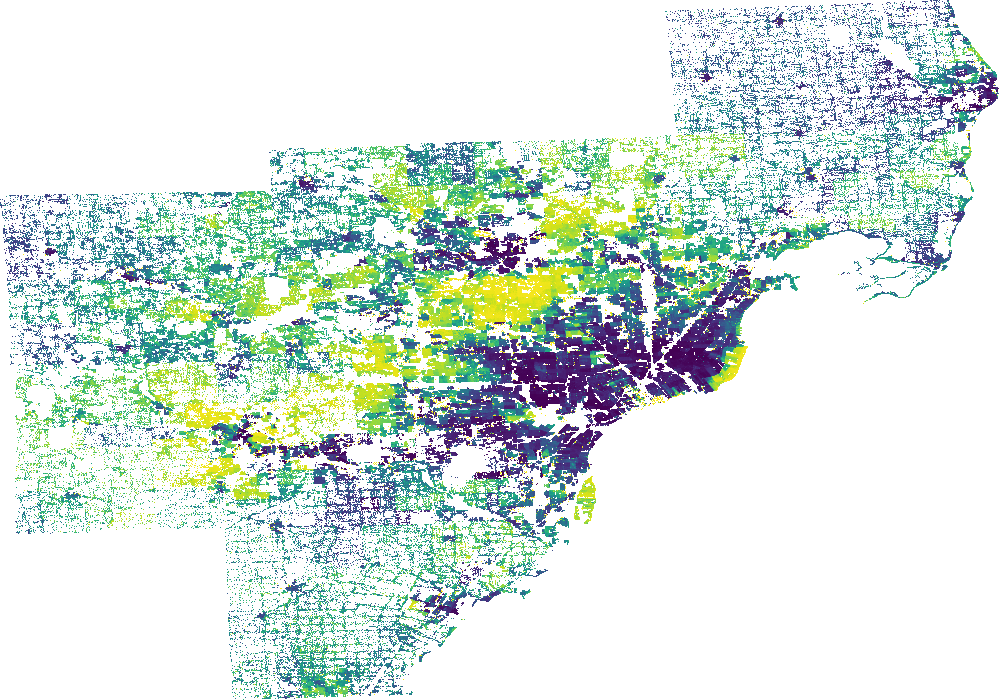

In [264]:
plot_probas(proba, alternatives)

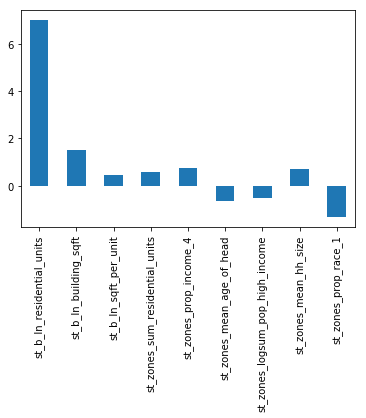

In [265]:
skew_plot(specification)

In [266]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 4_big_midage: more than 2 persons AND middle-aged head

Segment: household type = 17
Null Log-liklihood: -13815.511
Log-liklihood at convergence: -12191.137
Log-liklihood Ratio: 0.118

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.208   |   0.014    | -14.903 |
| st_b_ln_sqft_per_unit          |    1.474    |   0.075    |  19.665 |
| st_zones_sum_residential_units |    0.036    |   0.024    |  1.543  |
| st_zones_z_total_jobs          |    0.096    |   0.024    |  4.065  |
| st_zones_prop_income_4         |    0.513    |   0.031    |  16.672 |
| st_zones_mean_age_of_head      |    -0.132   |   0.033    |  -4.038 |
| st_zones_mean_hh_size          |    0.030    |   0.029    |  1.008  |
| st_zones_prop_race_1           |    0.487    |   0.042    |  11.740 |
+--------------------------------+-------------+------------+---------+
None
Co

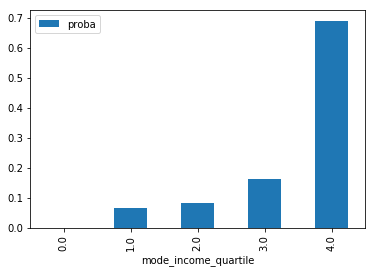

In [267]:
hh_type_ = 17
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
                'st_zones_sum_residential_units',
                'st_zones_z_total_jobs',
                'st_zones_prop_income_4',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ]
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

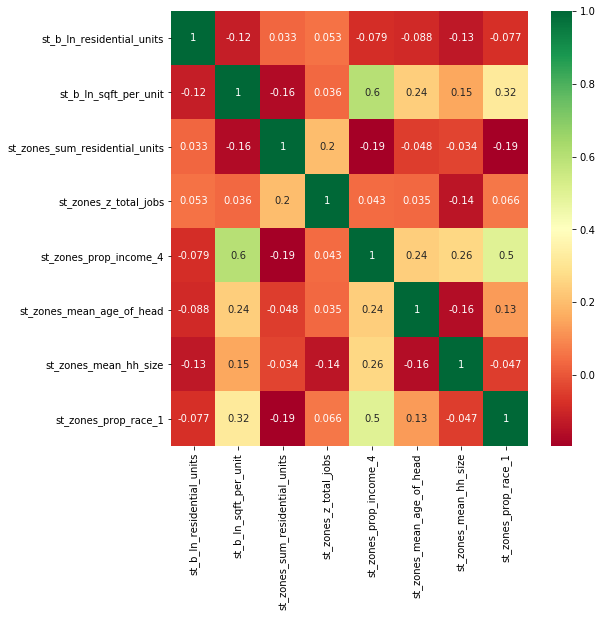

In [268]:
corr_plot(specification)

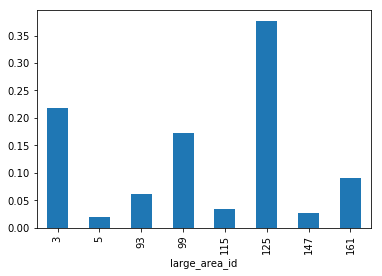

In [269]:
summed_probas('large_area_id', proba, alternatives)

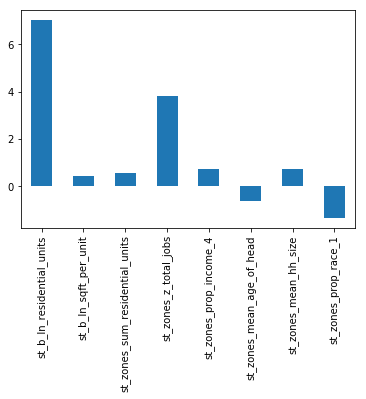

In [270]:
skew_plot(specification)

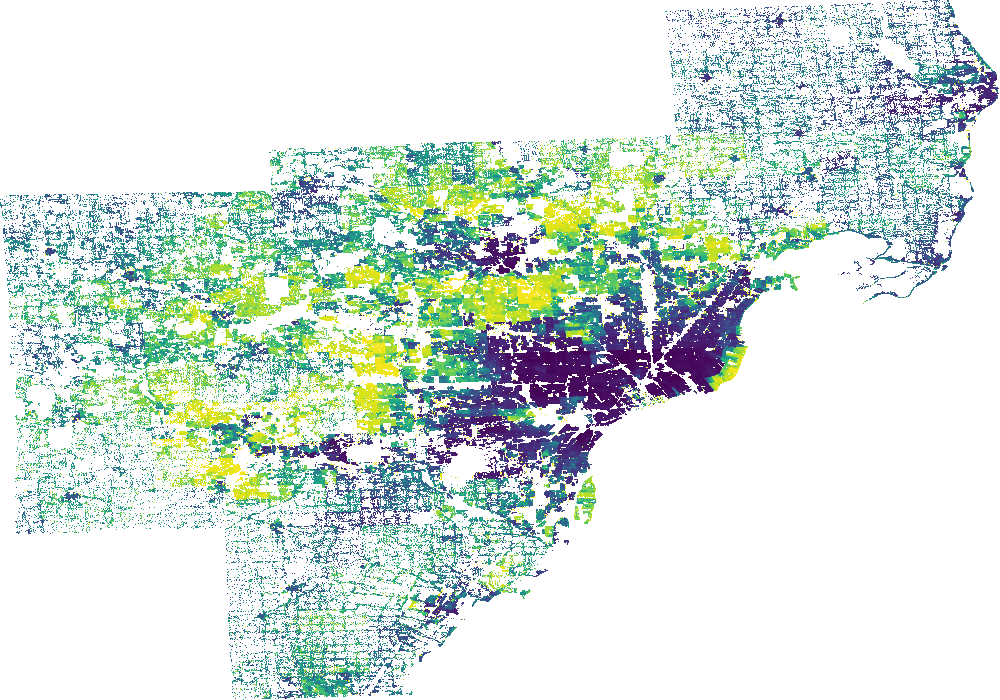

In [271]:
plot_probas(proba, alternatives)

In [272]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))

### 4_big_young: more than 2 persons AND YOUNG head

Segment: household type = 18
Null Log-liklihood: -10713.928
Log-liklihood at convergence: -9660.291
Log-liklihood Ratio: 0.098

+--------------------------------+-------------+------------+---------+
| Component                      | Coefficient | Std. Error | T-Score |
+--------------------------------+-------------+------------+---------+
| st_b_ln_residential_units      |    -0.127   |   0.012    | -10.184 |
| st_b_ln_sqft_per_unit          |    1.345    |   0.092    |  14.544 |
| st_zones_sum_residential_units |    0.056    |   0.025    |  2.256  |
| st_jobs_within_30_min          |    -0.056   |   0.034    |  -1.663 |
| st_zones_prop_income_4         |    0.307    |   0.037    |  8.340  |
| st_zones_mean_age_of_head      |    -0.387   |   0.025    | -15.567 |
| st_zones_mean_hh_size          |    -0.090   |   0.032    |  -2.807 |
| st_zones_prop_race_1           |    1.030    |   0.058    |  17.745 |
+--------------------------------+-------------+------------+---------+
None
Cor

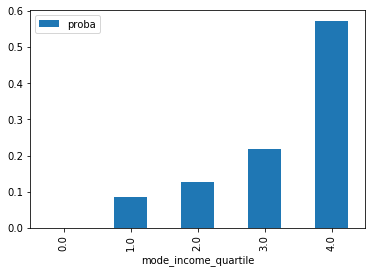

In [273]:
hh_type_ = 18
segment_filter = 'household_type == {}'.format(hh_type_)
specification = [
                'st_b_ln_residential_units',
                 'st_b_ln_sqft_per_unit',
                'st_zones_sum_residential_units',
                'st_jobs_within_30_min',
                'st_zones_prop_income_4',
                 'st_zones_mean_age_of_head',
                 'st_zones_mean_hh_size',
                 'st_zones_prop_race_1',
                ]
choosers_fit_filters = "(building_id_16 == -1)" + " & " + segment_filter
alts_fit_filters = 'occupied == 0'

m = dcm.MNLDiscreteChoiceModel(model_expression=specification,
                             sample_size=1000,
                             probability_mode='single_chooser',
                             choice_mode='aggregate',
                             estimation_sample_size=2000,
                             choosers_fit_filters=choosers_fit_filters,
                              alts_fit_filters = alts_fit_filters)
m.fit(choosers, alternatives, 'hh_spot_id')

proba = printing_results(m, hh_type_, choosers, alternatives)

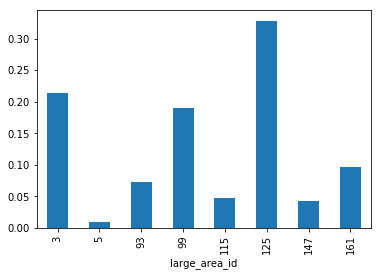

In [274]:
summed_probas('large_area_id', proba, alternatives)

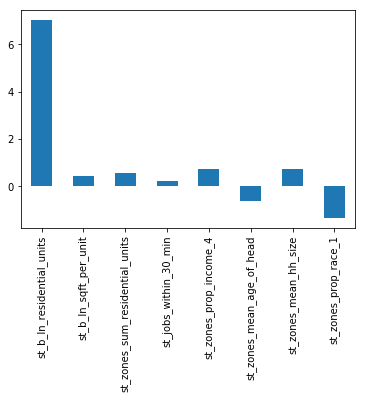

In [275]:
skew_plot(specification)

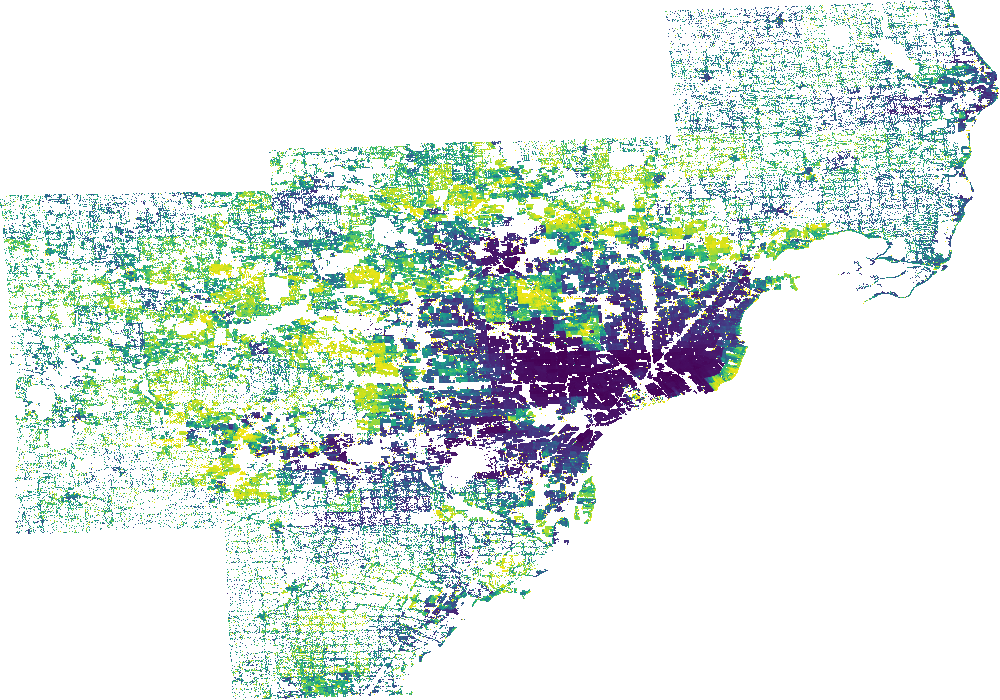

In [276]:
plot_probas(proba, alternatives)

In [277]:
m.choosers_predict_filters = "(building_id == -1)" + " & " + segment_filter
m.alts_predict_filters = "vacant_residential_units > 0"
m.choice_column = 'building_id'
m.to_yaml('./configs/hlcm_choosermover/hlcm{}.yaml'.format(hh_type_))